VGG16 code for sketch2face models 

In [2]:
#!/usr/bin/env python
__author__ = "Sreenivas Bhattiprolu"
__license__ = "Feel free to copy, I appreciate if you acknowledge Python for Microscopists"

# https://youtu.be/bIaT2X5Hd5k





from keras.layers import Conv2D, UpSampling2D, Input
from keras.models import Sequential, Model
from keras.preprocessing.image import ImageDataGenerator
from keras.utils import img_to_array, load_img
from skimage.color import rgb2lab, lab2rgb, gray2rgb
from skimage.transform import resize
from skimage.io import imsave
import numpy as np
import tensorflow as tf
import keras
import matplotlib.pyplot as plt
import os

"""
Because we are going to replace the encoder part with VGG16, 
we don’t need it as a classifier, we need it as a feature extractor so, 
the last dense layers isn’t needed we have to pop them up.

here, we iterate on each layer except the last dense layers so, 
we add 19 layer to our model. the dimension of last layer volume is “7x7x512”. 
we will be using that latent space volume as a feature vector to be input to the decoder.
 and the decoder is going to learn the mapping from the latent space vector to images. 
 we want the layers of VGG16 with its original weights without changing them, 
 so that we set the trainable parameter in each layer to false because we don’t want to train them again.
"""
from keras.applications.vgg16 import VGG16
vggmodel = VGG16()



2023-03-02 18:10:44.895114: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-02 18:10:48.720123: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
vggmodel.summary()


Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

Preprocessing

In [4]:
import cv2
from tqdm import tqdm 
import re
# to get the files in proper order
def sorted_alphanumeric(data):  
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)


# defining the size of image 
SIZE = 224

image_path = 'CUHK Dataset/CUHK_training_cropped_photos'
img_array = []

sketch_path = 'CUHK Dataset/CUHK_training_cropped_sketches'
sketch_array = []

image_file = sorted_alphanumeric(os.listdir(image_path))
sketch_file = sorted_alphanumeric(os.listdir(sketch_path))

image_test_path = 'CUHK Dataset/CUHK_testing_cropped_photos'
image_test_file = sorted_alphanumeric(os.listdir(image_test_path))
img_test_array = []

for i in tqdm(image_file):
    image = cv2.imread(image_path + '/' + i,1)
    
    # as opencv load image in bgr format converting it to rgb
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # resizing images 
    image = cv2.resize(image, (SIZE, SIZE))
    
    # normalizing image 
    image = image.astype('float32') / 255.0
    
    #appending normal normal image    
    img_array.append(img_to_array(image))
    # Image Augmentation
    
    # horizontal flip 
    img1 = cv2.flip(image,1)
    img_array.append(img_to_array(img1))
     #vertical flip 
    img2 = cv2.flip(image,-1)
    img_array.append(img_to_array(img2))
     #vertical flip 
    img3 = cv2.flip(image,-1)
    # horizontal flip
    img3 = cv2.flip(img3,1)
    img_array.append(img_to_array(img3))
    # rotate clockwise 
    img4 = cv2.rotate(image, cv2.ROTATE_90_CLOCKWISE)
    img_array.append(img_to_array(img4))
    # flip rotated image 
    img5 = cv2.flip(img4,1)
    img_array.append(img_to_array(img5))
     # rotate anti clockwise 
    img6 = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE)
    img_array.append(img_to_array(img6))
    # flip rotated image 
    img7 = cv2.flip(img6,1)
    img_array.append(img_to_array(img7))
  
    
for i in tqdm(sketch_file):
    image = cv2.imread(sketch_path + '/' + i,1)
    
    # as opencv load image in bgr format converting it to rgb
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # resizing images 
    image = cv2.resize(image, (SIZE, SIZE))
    
    # normalizing image 
    image = image.astype('float32') / 255.0
    # appending normal sketch image
    sketch_array.append(img_to_array(image))
    
    #Image Augmentation
    # horizontal flip 
    img1 = cv2.flip(image,1)
    sketch_array.append(img_to_array(img1))
     #vertical flip 
    img2 = cv2.flip(image,-1)
    sketch_array.append(img_to_array(img2))
     #vertical flip 
    img3 = cv2.flip(image,-1)
    # horizontal flip
    img3 = cv2.flip(img3,1)
    sketch_array.append(img_to_array(img3))
    # rotate clockwise 
    img4 = cv2.rotate(image, cv2.ROTATE_90_CLOCKWISE)
    sketch_array.append(img_to_array(img4))
    # flip rotated image 
    img5 = cv2.flip(img4,1)
    sketch_array.append(img_to_array(img5))
     # rotate anti clockwise 
    img6 = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE)
    sketch_array.append(img_to_array(img6))
    # flip rotated image 
    img7 = cv2.flip(img6,1)
    sketch_array.append(img_to_array(img7))
    
print("Total number of sketch images:",len(sketch_array))
print("Total number of images:",len(img_array))

train_sketch = sketch_array
train_image = img_array

for i in tqdm(image_test_file):
    image = cv2.imread(image_test_path + '/' + i,1)
    
    # as opencv load image in bgr format converting it to rgb
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # resizing images 
    image = cv2.resize(image, (SIZE, SIZE))
    
    # normalizing image 
    image = image.astype('float32') / 255.0
    
    #appending normal normal image    
    img_test_array.append(img_to_array(image))
    # Image Augmentation

test_image = img_test_array

sketch_test_path = 'CUHK Dataset/CUHK_testing_cropped_sketches'
sketch_test_file = sorted_alphanumeric(os.listdir(sketch_test_path))
sketch_test_array = []

for i in tqdm(sketch_test_file):
    image = cv2.imread(sketch_test_path + '/' + i,1)
    
    # as opencv load image in bgr format converting it to rgb
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # resizing images 
    image = cv2.resize(image, (SIZE, SIZE))
    
    # normalizing image 
    image = image.astype('float32') / 255.0
    
    #appending normal normal image    
    sketch_test_array.append(img_to_array(image))
    # Image Augmentation

test_sketch = sketch_test_array

100%|██████████| 88/88 [00:00<00:00, 504.93it/s]


Total number of sketch images: 704
Total number of images: 704


100%|██████████| 100/100 [00:00<00:00, 1440.84it/s]


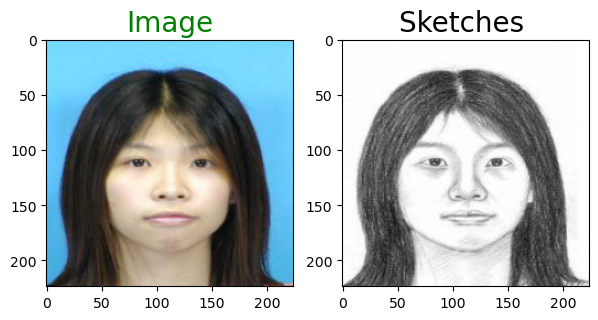

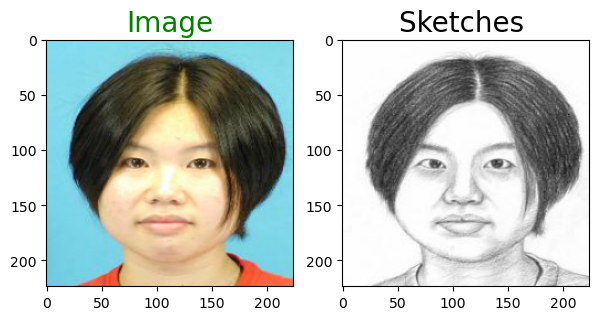

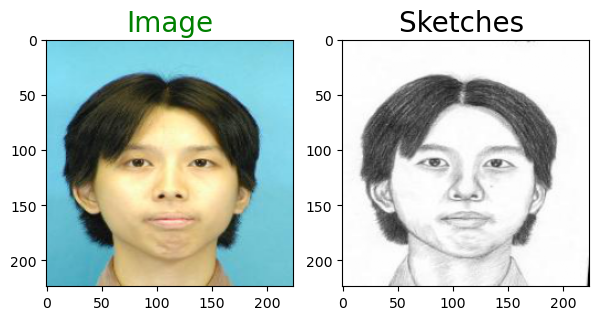

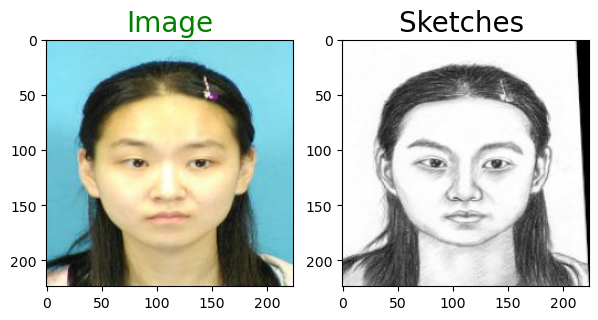

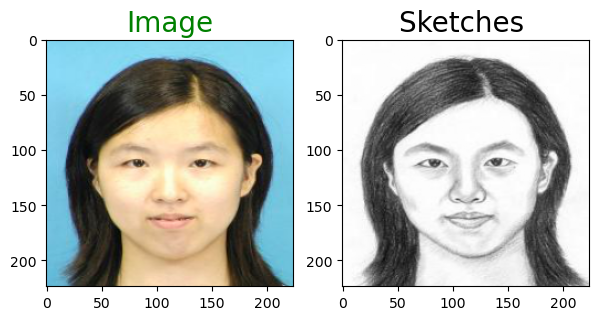

...

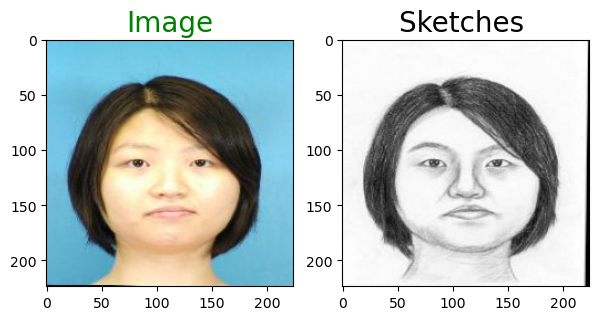

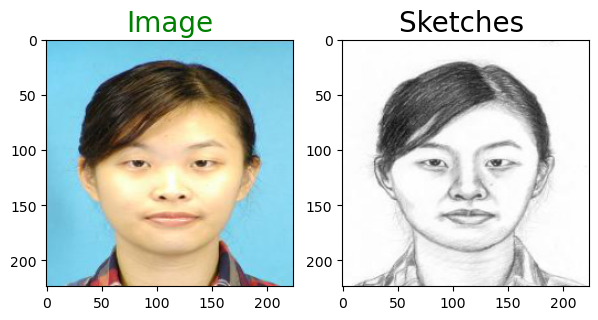

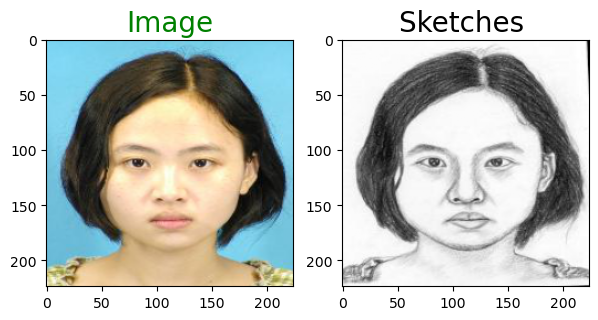

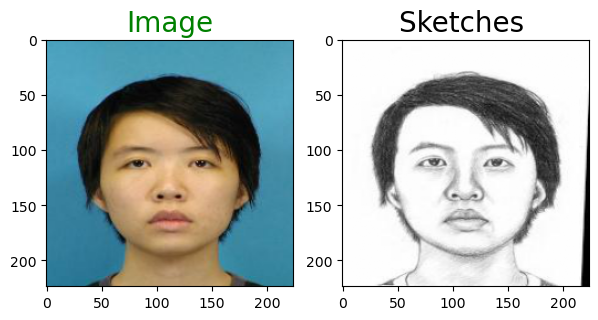

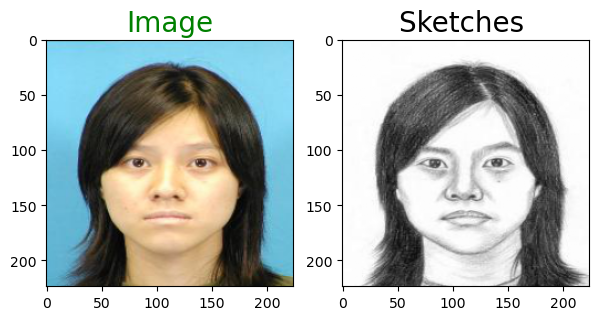

In [3]:

# defining function to plot images pair
def plot_images(image, sketches):
    plt.figure(figsize=(7,7))
    plt.subplot(1,2,1)
    plt.title('Image', color = 'green', fontsize = 20)
    plt.imshow(image)
    plt.subplot(1,2,2)
    plt.title('Sketches ', color = 'black', fontsize = 20)
    plt.imshow(sketches)
   
    plt.show()

ls = [i for i in range(0,104,8)]
for i in ls:
    plot_images(img_array[i],sketch_array[i])


In [6]:
newmodel = Sequential()
#num = 0
for i, layer in enumerate(vggmodel.layers):
    if i<19:          #Only up to 19th layer to include feature extraction only
      newmodel.add(layer)
newmodel.summary()
for layer in newmodel.layers:
  layer.trainable=False   #We don't want to train these layers again, so False. 

"""
VGG16 is expecting an image of 3 dimension with size 224x224 as an input, 
in preprocessing we have to scale all images to 224 instead of 256
"""
newmodel.save("VGG16_pretrained.model")
print(len(train_image)) 

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0         
                                                                 
 block3_conv1 (Conv2D)       (None, 56, 56, 256)      

INFO:tensorflow:Assets written to: VGG16_pretrained.model/assets


INFO:tensorflow:Assets written to: VGG16_pretrained.model/assets


704


In [5]:

Y = np.array(img_array)


(224, 224, 3)
(1, 224, 224, 3)
(704, 224, 224, 3)


In [6]:
#get features from vgg16

vggfeatures = []
for i in range(len(sketch_array)):
  sample = sketch_array[i]
  sample = sample.reshape((1,224,224,3))
  prediction = newmodel.predict(sample)
  prediction = prediction.reshape((7,7,512))
  vggfeatures.append(prediction)
vggfeatures = np.array(vggfeatures)
print(vggfeatures.shape)




1/1 [==============================] - 0s 151ms/step
(704, 7, 7, 512)


In [111]:
#Decoder
model = Sequential()

model.add(Conv2D(256, (3,3), activation='relu', padding='same', input_shape=(7,7,512)))
model.add(Conv2D(128, (3,3), activation='relu', padding='same'))
model.add(UpSampling2D((2, 2)))
model.add(Conv2D(64, (3,3), activation='relu', padding='same'))
model.add(UpSampling2D((2, 2)))
model.add(Conv2D(32, (3,3), activation='relu', padding='same'))
model.add(UpSampling2D((2, 2)))
model.add(Conv2D(16, (3,3), activation='relu', padding='same'))
model.add(UpSampling2D((2, 2)))
#changed to 3
model.add(Conv2D(3, (3, 3), activation='tanh', padding='same'))
model.add(UpSampling2D((2, 2)))
model.summary()

Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_146 (Conv2D)         (None, 7, 7, 256)         1179904   
                                                                 
 conv2d_147 (Conv2D)         (None, 7, 7, 128)         295040    
                                                                 
 up_sampling2d_125 (UpSampli  (None, 14, 14, 128)      0         
 ng2D)                                                           
                                                                 
 conv2d_148 (Conv2D)         (None, 14, 14, 64)        73792     
                                                                 
 up_sampling2d_126 (UpSampli  (None, 28, 28, 64)       0         
 ng2D)                                                           
                                                                 
 conv2d_149 (Conv2D)         (None, 28, 28, 32)      

Epoch 1/10000
5/5 [==============================] - 4s 747ms/step - loss: 0.2922 - accuracy: 0.3153 - val_loss: 0.1955 - val_accuracy: 0.4365
Epoch 2/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.2273 - accuracy: 0.5930 - val_loss: 0.2039 - val_accuracy: 0.7377
Epoch 3/10000
5/5 [==============================] - 4s 711ms/step - loss: 0.2219 - accuracy: 0.7322 - val_loss: 0.1859 - val_accuracy: 0.7099
Epoch 4/10000
5/5 [==============================] - 3s 697ms/step - loss: 0.2299 - accuracy: 0.7100 - val_loss: 0.2044 - val_accuracy: 0.3916
Epoch 5/10000
5/5 [==============================] - 4s 729ms/step - loss: 0.2277 - accuracy: 0.3543 - val_loss: 0.2038 - val_accuracy: 0.3206
Epoch 6/10000
5/5 [==============================] - 4s 708ms/step - loss: 0.2269 - accuracy: 0.3253 - val_loss: 0.2023 - val_accuracy: 0.3068
Epoch 7/10000
5/5 [==============================] - 3s 705ms/step - loss: 0.2252 - accuracy: 0.3277 - val_loss: 0.1995 - val_accuracy: 0.3438

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_00500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_00500.model/assets


5/5 [==============================] - 4s 942ms/step - loss: 0.0052 - accuracy: 0.9161 - val_loss: 0.0218 - val_accuracy: 0.9110
Epoch 501/10000
5/5 [==============================] - 4s 729ms/step - loss: 0.0052 - accuracy: 0.9163 - val_loss: 0.0220 - val_accuracy: 0.9103
Epoch 502/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0052 - accuracy: 0.9160 - val_loss: 0.0221 - val_accuracy: 0.9096
Epoch 503/10000
5/5 [==============================] - 4s 707ms/step - loss: 0.0054 - accuracy: 0.9147 - val_loss: 0.0225 - val_accuracy: 0.9095
Epoch 504/10000
5/5 [==============================] - 3s 701ms/step - loss: 0.0055 - accuracy: 0.9150 - val_loss: 0.0222 - val_accuracy: 0.9109
Epoch 505/10000
5/5 [==============================] - 4s 720ms/step - loss: 0.0053 - accuracy: 0.9162 - val_loss: 0.0222 - val_accuracy: 0.9107
Epoch 506/10000
5/5 [==============================] - 4s 707ms/step - loss: 0.0053 - accuracy: 0.9159 - val_loss: 0.0218 - val_accuracy: 0.9119
E

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_01000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_01000.model/assets


5/5 [==============================] - 4s 884ms/step - loss: 0.0039 - accuracy: 0.9218 - val_loss: 0.0229 - val_accuracy: 0.9075
Epoch 1001/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0042 - accuracy: 0.9205 - val_loss: 0.0229 - val_accuracy: 0.9073
Epoch 1002/10000
5/5 [==============================] - 4s 711ms/step - loss: 0.0041 - accuracy: 0.9204 - val_loss: 0.0228 - val_accuracy: 0.9091
Epoch 1003/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0040 - accuracy: 0.9212 - val_loss: 0.0227 - val_accuracy: 0.9080
Epoch 1004/10000
5/5 [==============================] - 3s 703ms/step - loss: 0.0040 - accuracy: 0.9215 - val_loss: 0.0230 - val_accuracy: 0.9065
Epoch 1005/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0039 - accuracy: 0.9214 - val_loss: 0.0229 - val_accuracy: 0.9081
Epoch 1006/10000
5/5 [==============================] - 4s 724ms/step - loss: 0.0039 - accuracy: 0.9214 - val_loss: 0.0228 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_01500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_01500.model/assets


5/5 [==============================] - 4s 881ms/step - loss: 0.0036 - accuracy: 0.9207 - val_loss: 0.0234 - val_accuracy: 0.9069
Epoch 1501/10000
5/5 [==============================] - 3s 705ms/step - loss: 0.0036 - accuracy: 0.9211 - val_loss: 0.0235 - val_accuracy: 0.9034
Epoch 1502/10000
5/5 [==============================] - 4s 707ms/step - loss: 0.0036 - accuracy: 0.9206 - val_loss: 0.0232 - val_accuracy: 0.9058
Epoch 1503/10000
5/5 [==============================] - 4s 730ms/step - loss: 0.0035 - accuracy: 0.9211 - val_loss: 0.0231 - val_accuracy: 0.9064
Epoch 1504/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0034 - accuracy: 0.9212 - val_loss: 0.0232 - val_accuracy: 0.9053
Epoch 1505/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0034 - accuracy: 0.9214 - val_loss: 0.0233 - val_accuracy: 0.9050
Epoch 1506/10000
5/5 [==============================] - 3s 701ms/step - loss: 0.0033 - accuracy: 0.9216 - val_loss: 0.0232 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_02000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_02000.model/assets


5/5 [==============================] - 4s 904ms/step - loss: 0.0030 - accuracy: 0.9232 - val_loss: 0.0236 - val_accuracy: 0.9053
Epoch 2001/10000
5/5 [==============================] - 3s 697ms/step - loss: 0.0030 - accuracy: 0.9233 - val_loss: 0.0235 - val_accuracy: 0.9045
Epoch 2002/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0029 - accuracy: 0.9233 - val_loss: 0.0237 - val_accuracy: 0.9046
Epoch 2003/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0030 - accuracy: 0.9225 - val_loss: 0.0237 - val_accuracy: 0.9046
Epoch 2004/10000
5/5 [==============================] - 4s 724ms/step - loss: 0.0035 - accuracy: 0.9216 - val_loss: 0.0240 - val_accuracy: 0.9019
Epoch 2005/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0033 - accuracy: 0.9220 - val_loss: 0.0235 - val_accuracy: 0.9043
Epoch 2006/10000
5/5 [==============================] - 3s 695ms/step - loss: 0.0034 - accuracy: 0.9212 - val_loss: 0.0239 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_02500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_02500.model/assets


5/5 [==============================] - 4s 902ms/step - loss: 0.0030 - accuracy: 0.9239 - val_loss: 0.0237 - val_accuracy: 0.9041
Epoch 2501/10000
5/5 [==============================] - 3s 698ms/step - loss: 0.0030 - accuracy: 0.9234 - val_loss: 0.0237 - val_accuracy: 0.9045
Epoch 2502/10000
5/5 [==============================] - 3s 703ms/step - loss: 0.0031 - accuracy: 0.9236 - val_loss: 0.0238 - val_accuracy: 0.9012
Epoch 2503/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0030 - accuracy: 0.9237 - val_loss: 0.0238 - val_accuracy: 0.9061
Epoch 2504/10000
5/5 [==============================] - 4s 723ms/step - loss: 0.0029 - accuracy: 0.9238 - val_loss: 0.0240 - val_accuracy: 0.9035
Epoch 2505/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0029 - accuracy: 0.9239 - val_loss: 0.0237 - val_accuracy: 0.9058
Epoch 2506/10000
5/5 [==============================] - 3s 698ms/step - loss: 0.0029 - accuracy: 0.9238 - val_loss: 0.0241 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_03000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_03000.model/assets


5/5 [==============================] - 4s 930ms/step - loss: 0.0027 - accuracy: 0.9276 - val_loss: 0.0242 - val_accuracy: 0.9059
Epoch 3001/10000
5/5 [==============================] - 4s 724ms/step - loss: 0.0026 - accuracy: 0.9281 - val_loss: 0.0243 - val_accuracy: 0.9057
Epoch 3002/10000
5/5 [==============================] - 4s 709ms/step - loss: 0.0026 - accuracy: 0.9278 - val_loss: 0.0242 - val_accuracy: 0.9066
Epoch 3003/10000
5/5 [==============================] - 4s 710ms/step - loss: 0.0026 - accuracy: 0.9279 - val_loss: 0.0241 - val_accuracy: 0.9081
Epoch 3004/10000
5/5 [==============================] - 4s 710ms/step - loss: 0.0026 - accuracy: 0.9278 - val_loss: 0.0243 - val_accuracy: 0.9071
Epoch 3005/10000
5/5 [==============================] - 4s 724ms/step - loss: 0.0026 - accuracy: 0.9280 - val_loss: 0.0243 - val_accuracy: 0.9074
Epoch 3006/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0026 - accuracy: 0.9283 - val_loss: 0.0243 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_03500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_03500.model/assets


5/5 [==============================] - 4s 890ms/step - loss: 0.0027 - accuracy: 0.9281 - val_loss: 0.0244 - val_accuracy: 0.9083
Epoch 3501/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0029 - accuracy: 0.9282 - val_loss: 0.0245 - val_accuracy: 0.9063
Epoch 3502/10000
5/5 [==============================] - 4s 722ms/step - loss: 0.0027 - accuracy: 0.9273 - val_loss: 0.0244 - val_accuracy: 0.9064
Epoch 3503/10000
5/5 [==============================] - 4s 707ms/step - loss: 0.0027 - accuracy: 0.9278 - val_loss: 0.0248 - val_accuracy: 0.9060
Epoch 3504/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0027 - accuracy: 0.9279 - val_loss: 0.0247 - val_accuracy: 0.9068
Epoch 3505/10000
5/5 [==============================] - 4s 709ms/step - loss: 0.0026 - accuracy: 0.9282 - val_loss: 0.0244 - val_accuracy: 0.9069
Epoch 3506/10000
5/5 [==============================] - 4s 720ms/step - loss: 0.0026 - accuracy: 0.9284 - val_loss: 0.0244 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_04000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_04000.model/assets


5/5 [==============================] - 4s 889ms/step - loss: 0.0024 - accuracy: 0.9292 - val_loss: 0.0246 - val_accuracy: 0.9071
Epoch 4001/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0024 - accuracy: 0.9289 - val_loss: 0.0246 - val_accuracy: 0.9070
Epoch 4002/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0024 - accuracy: 0.9288 - val_loss: 0.0246 - val_accuracy: 0.9071
Epoch 4003/10000
5/5 [==============================] - 4s 724ms/step - loss: 0.0024 - accuracy: 0.9291 - val_loss: 0.0246 - val_accuracy: 0.9069
Epoch 4004/10000
5/5 [==============================] - 3s 701ms/step - loss: 0.0024 - accuracy: 0.9291 - val_loss: 0.0246 - val_accuracy: 0.9062
Epoch 4005/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0024 - accuracy: 0.9287 - val_loss: 0.0245 - val_accuracy: 0.9070
Epoch 4006/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0024 - accuracy: 0.9289 - val_loss: 0.0247 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_04500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_04500.model/assets


5/5 [==============================] - 4s 904ms/step - loss: 0.0024 - accuracy: 0.9293 - val_loss: 0.0247 - val_accuracy: 0.9065
Epoch 4501/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0023 - accuracy: 0.9294 - val_loss: 0.0249 - val_accuracy: 0.9066
Epoch 4502/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0023 - accuracy: 0.9290 - val_loss: 0.0248 - val_accuracy: 0.9057
Epoch 4503/10000
5/5 [==============================] - 3s 706ms/step - loss: 0.0023 - accuracy: 0.9294 - val_loss: 0.0248 - val_accuracy: 0.9064
Epoch 4504/10000
5/5 [==============================] - 4s 731ms/step - loss: 0.0023 - accuracy: 0.9292 - val_loss: 0.0248 - val_accuracy: 0.9060
Epoch 4505/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0023 - accuracy: 0.9293 - val_loss: 0.0250 - val_accuracy: 0.9054
Epoch 4506/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0024 - accuracy: 0.9291 - val_loss: 0.0249 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_05000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_05000.model/assets


5/5 [==============================] - 4s 884ms/step - loss: 0.0023 - accuracy: 0.9294 - val_loss: 0.0248 - val_accuracy: 0.9064
Epoch 5001/10000
5/5 [==============================] - 4s 715ms/step - loss: 0.0023 - accuracy: 0.9295 - val_loss: 0.0249 - val_accuracy: 0.9062
Epoch 5002/10000
5/5 [==============================] - 3s 705ms/step - loss: 0.0023 - accuracy: 0.9296 - val_loss: 0.0250 - val_accuracy: 0.9061
Epoch 5003/10000
5/5 [==============================] - 4s 709ms/step - loss: 0.0023 - accuracy: 0.9294 - val_loss: 0.0250 - val_accuracy: 0.9065
Epoch 5004/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0023 - accuracy: 0.9296 - val_loss: 0.0249 - val_accuracy: 0.9063
Epoch 5005/10000
5/5 [==============================] - 4s 728ms/step - loss: 0.0022 - accuracy: 0.9297 - val_loss: 0.0250 - val_accuracy: 0.9055
Epoch 5006/10000
5/5 [==============================] - 4s 709ms/step - loss: 0.0022 - accuracy: 0.9295 - val_loss: 0.0250 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_05500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_05500.model/assets


5/5 [==============================] - 4s 928ms/step - loss: 0.0022 - accuracy: 0.9297 - val_loss: 0.0253 - val_accuracy: 0.9063
Epoch 5501/10000
5/5 [==============================] - 4s 714ms/step - loss: 0.0023 - accuracy: 0.9297 - val_loss: 0.0253 - val_accuracy: 0.9051
Epoch 5502/10000
5/5 [==============================] - 4s 712ms/step - loss: 0.0022 - accuracy: 0.9297 - val_loss: 0.0253 - val_accuracy: 0.9054
Epoch 5503/10000
5/5 [==============================] - 3s 703ms/step - loss: 0.0022 - accuracy: 0.9296 - val_loss: 0.0252 - val_accuracy: 0.9054
Epoch 5504/10000
5/5 [==============================] - 3s 697ms/step - loss: 0.0024 - accuracy: 0.9291 - val_loss: 0.0256 - val_accuracy: 0.9042
Epoch 5505/10000
5/5 [==============================] - 3s 703ms/step - loss: 0.0025 - accuracy: 0.9288 - val_loss: 0.0254 - val_accuracy: 0.9067
Epoch 5506/10000
5/5 [==============================] - 4s 727ms/step - loss: 0.0024 - accuracy: 0.9291 - val_loss: 0.0254 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_06000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_06000.model/assets


5/5 [==============================] - 4s 891ms/step - loss: 0.0023 - accuracy: 0.9299 - val_loss: 0.0254 - val_accuracy: 0.9068
Epoch 6001/10000
5/5 [==============================] - 4s 705ms/step - loss: 0.0024 - accuracy: 0.9293 - val_loss: 0.0263 - val_accuracy: 0.9036
Epoch 6002/10000
5/5 [==============================] - 3s 705ms/step - loss: 0.0028 - accuracy: 0.9287 - val_loss: 0.0255 - val_accuracy: 0.9072
Epoch 6003/10000
5/5 [==============================] - 4s 719ms/step - loss: 0.0026 - accuracy: 0.9288 - val_loss: 0.0254 - val_accuracy: 0.9045
Epoch 6004/10000
5/5 [==============================] - 3s 703ms/step - loss: 0.0025 - accuracy: 0.9286 - val_loss: 0.0255 - val_accuracy: 0.9059
Epoch 6005/10000
5/5 [==============================] - 3s 701ms/step - loss: 0.0025 - accuracy: 0.9281 - val_loss: 0.0253 - val_accuracy: 0.9075
Epoch 6006/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0024 - accuracy: 0.9294 - val_loss: 0.0254 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_06500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_06500.model/assets


5/5 [==============================] - 4s 885ms/step - loss: 0.0021 - accuracy: 0.9302 - val_loss: 0.0254 - val_accuracy: 0.9054
Epoch 6501/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0021 - accuracy: 0.9300 - val_loss: 0.0256 - val_accuracy: 0.9044
Epoch 6502/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0021 - accuracy: 0.9298 - val_loss: 0.0255 - val_accuracy: 0.9049
Epoch 6503/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0021 - accuracy: 0.9301 - val_loss: 0.0255 - val_accuracy: 0.9048
Epoch 6504/10000
5/5 [==============================] - 4s 709ms/step - loss: 0.0021 - accuracy: 0.9301 - val_loss: 0.0255 - val_accuracy: 0.9049
Epoch 6505/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0021 - accuracy: 0.9300 - val_loss: 0.0255 - val_accuracy: 0.9049
Epoch 6506/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0021 - accuracy: 0.9300 - val_loss: 0.0256 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_07000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_07000.model/assets


5/5 [==============================] - 4s 901ms/step - loss: 0.0021 - accuracy: 0.9301 - val_loss: 0.0255 - val_accuracy: 0.9048
Epoch 7001/10000
5/5 [==============================] - 4s 707ms/step - loss: 0.0021 - accuracy: 0.9299 - val_loss: 0.0257 - val_accuracy: 0.9049
Epoch 7002/10000
5/5 [==============================] - 4s 707ms/step - loss: 0.0021 - accuracy: 0.9301 - val_loss: 0.0256 - val_accuracy: 0.9051
Epoch 7003/10000
5/5 [==============================] - 4s 708ms/step - loss: 0.0021 - accuracy: 0.9300 - val_loss: 0.0257 - val_accuracy: 0.9046
Epoch 7004/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0022 - accuracy: 0.9301 - val_loss: 0.0255 - val_accuracy: 0.9059
Epoch 7005/10000
5/5 [==============================] - 4s 720ms/step - loss: 0.0022 - accuracy: 0.9301 - val_loss: 0.0258 - val_accuracy: 0.9042
Epoch 7006/10000
5/5 [==============================] - 3s 703ms/step - loss: 0.0023 - accuracy: 0.9298 - val_loss: 0.0256 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_07500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_07500.model/assets


5/5 [==============================] - 4s 888ms/step - loss: 0.0022 - accuracy: 0.9302 - val_loss: 0.0257 - val_accuracy: 0.9048
Epoch 7501/10000
5/5 [==============================] - 4s 709ms/step - loss: 0.0021 - accuracy: 0.9301 - val_loss: 0.0258 - val_accuracy: 0.9045
Epoch 7502/10000
5/5 [==============================] - 4s 711ms/step - loss: 0.0021 - accuracy: 0.9300 - val_loss: 0.0257 - val_accuracy: 0.9053
Epoch 7503/10000
5/5 [==============================] - 4s 723ms/step - loss: 0.0021 - accuracy: 0.9301 - val_loss: 0.0257 - val_accuracy: 0.9047
Epoch 7504/10000
5/5 [==============================] - 3s 703ms/step - loss: 0.0021 - accuracy: 0.9300 - val_loss: 0.0257 - val_accuracy: 0.9051
Epoch 7505/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0021 - accuracy: 0.9304 - val_loss: 0.0257 - val_accuracy: 0.9047
Epoch 7506/10000
5/5 [==============================] - 4s 728ms/step - loss: 0.0022 - accuracy: 0.9293 - val_loss: 0.0259 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_08000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_08000.model/assets


5/5 [==============================] - 4s 937ms/step - loss: 0.0022 - accuracy: 0.9303 - val_loss: 0.0261 - val_accuracy: 0.9036
Epoch 8001/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0022 - accuracy: 0.9299 - val_loss: 0.0258 - val_accuracy: 0.9047
Epoch 8002/10000
5/5 [==============================] - 4s 723ms/step - loss: 0.0021 - accuracy: 0.9301 - val_loss: 0.0257 - val_accuracy: 0.9052
Epoch 8003/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0021 - accuracy: 0.9304 - val_loss: 0.0257 - val_accuracy: 0.9056
Epoch 8004/10000
5/5 [==============================] - 4s 703ms/step - loss: 0.0021 - accuracy: 0.9303 - val_loss: 0.0257 - val_accuracy: 0.9051
Epoch 8005/10000
5/5 [==============================] - 3s 703ms/step - loss: 0.0021 - accuracy: 0.9303 - val_loss: 0.0259 - val_accuracy: 0.9038
Epoch 8006/10000
5/5 [==============================] - 3s 701ms/step - loss: 0.0022 - accuracy: 0.9298 - val_loss: 0.0258 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_08500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_08500.model/assets


5/5 [==============================] - 4s 887ms/step - loss: 0.0021 - accuracy: 0.9304 - val_loss: 0.0259 - val_accuracy: 0.9043
Epoch 8501/10000
5/5 [==============================] - 4s 709ms/step - loss: 0.0021 - accuracy: 0.9300 - val_loss: 0.0258 - val_accuracy: 0.9052
Epoch 8502/10000
5/5 [==============================] - 4s 710ms/step - loss: 0.0021 - accuracy: 0.9303 - val_loss: 0.0258 - val_accuracy: 0.9052
Epoch 8503/10000
5/5 [==============================] - 4s 729ms/step - loss: 0.0021 - accuracy: 0.9301 - val_loss: 0.0258 - val_accuracy: 0.9058
Epoch 8504/10000
5/5 [==============================] - 4s 709ms/step - loss: 0.0021 - accuracy: 0.9307 - val_loss: 0.0259 - val_accuracy: 0.9057
Epoch 8505/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0021 - accuracy: 0.9303 - val_loss: 0.0260 - val_accuracy: 0.9044
Epoch 8506/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0021 - accuracy: 0.9301 - val_loss: 0.0259 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_09000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_09000.model/assets


5/5 [==============================] - 4s 897ms/step - loss: 0.0022 - accuracy: 0.9299 - val_loss: 0.0263 - val_accuracy: 0.9045
Epoch 9001/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0022 - accuracy: 0.9299 - val_loss: 0.0261 - val_accuracy: 0.9055
Epoch 9002/10000
5/5 [==============================] - 3s 706ms/step - loss: 0.0022 - accuracy: 0.9305 - val_loss: 0.0263 - val_accuracy: 0.9037
Epoch 9003/10000
5/5 [==============================] - 3s 705ms/step - loss: 0.0022 - accuracy: 0.9300 - val_loss: 0.0258 - val_accuracy: 0.9058
Epoch 9004/10000
5/5 [==============================] - 4s 728ms/step - loss: 0.0022 - accuracy: 0.9304 - val_loss: 0.0261 - val_accuracy: 0.9043
Epoch 9005/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0021 - accuracy: 0.9300 - val_loss: 0.0261 - val_accuracy: 0.9054
Epoch 9006/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0021 - accuracy: 0.9306 - val_loss: 0.0262 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_09500.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_09500.model/assets


5/5 [==============================] - 4s 900ms/step - loss: 0.0022 - accuracy: 0.9302 - val_loss: 0.0262 - val_accuracy: 0.9046
Epoch 9501/10000
5/5 [==============================] - 4s 706ms/step - loss: 0.0022 - accuracy: 0.9298 - val_loss: 0.0261 - val_accuracy: 0.9051
Epoch 9502/10000
5/5 [==============================] - 4s 707ms/step - loss: 0.0022 - accuracy: 0.9297 - val_loss: 0.0260 - val_accuracy: 0.9058
Epoch 9503/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0021 - accuracy: 0.9306 - val_loss: 0.0261 - val_accuracy: 0.9049
Epoch 9504/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0021 - accuracy: 0.9303 - val_loss: 0.0261 - val_accuracy: 0.9052
Epoch 9505/10000
5/5 [==============================] - 4s 721ms/step - loss: 0.0021 - accuracy: 0.9306 - val_loss: 0.0260 - val_accuracy: 0.9056
Epoch 9506/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0021 - accuracy: 0.9302 - val_loss: 0.0261 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_10000.model/assets


INFO:tensorflow:Assets written to: vgg16_test_models/VGG16_10000.model/assets


5/5 [==============================] - 4s 890ms/step - loss: 0.0022 - accuracy: 0.9305 - val_loss: 0.0265 - val_accuracy: 0.9039


INFO:tensorflow:Assets written to: VGG16_s2f_generator_10000.model/assets


INFO:tensorflow:Assets written to: VGG16_s2f_generator_10000.model/assets


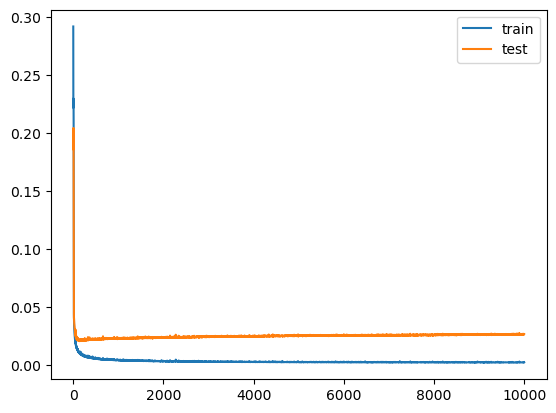

In [112]:
checkpoint = keras.callbacks.ModelCheckpoint('vgg16_test_models/VGG16_{epoch:05d}.model', period=500) 
model.compile(optimizer='Adam', loss='mse' , metrics=['accuracy'])
history = model.fit(vggfeatures, Y, verbose=1, epochs=10000, validation_split=0.1, batch_size=128, callbacks=[checkpoint])

model.save('VGG16_s2f_generator_10000.model')

plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()

Test images:
1/1 [==============================] - 0s 77ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 28ms/step


Train images:
1/1 [==============================] - 0s 24ms/step


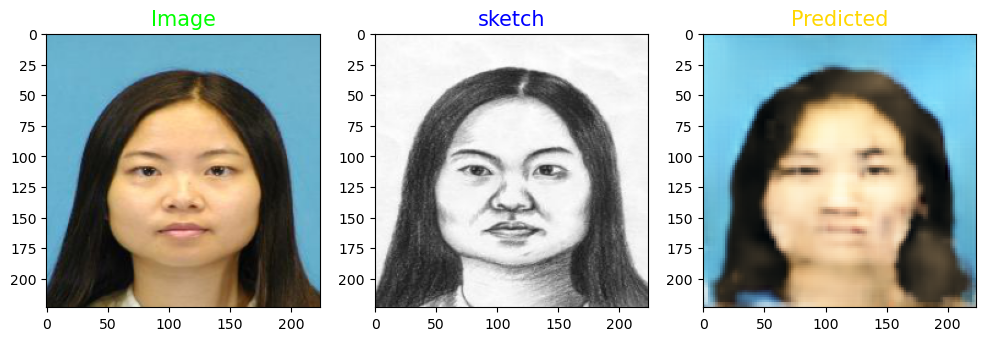

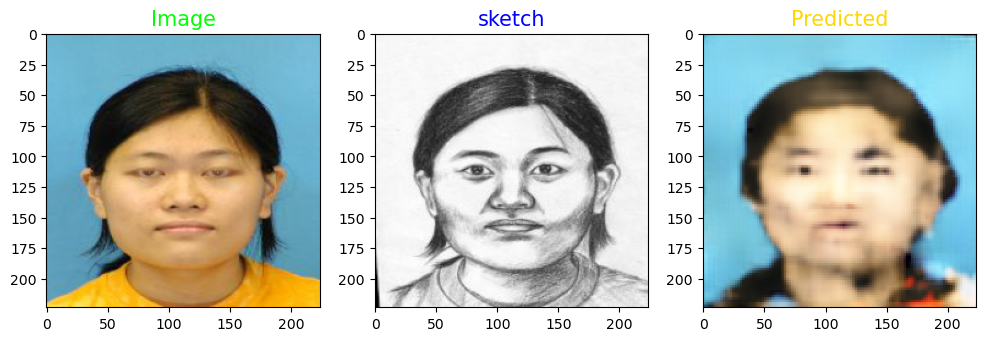

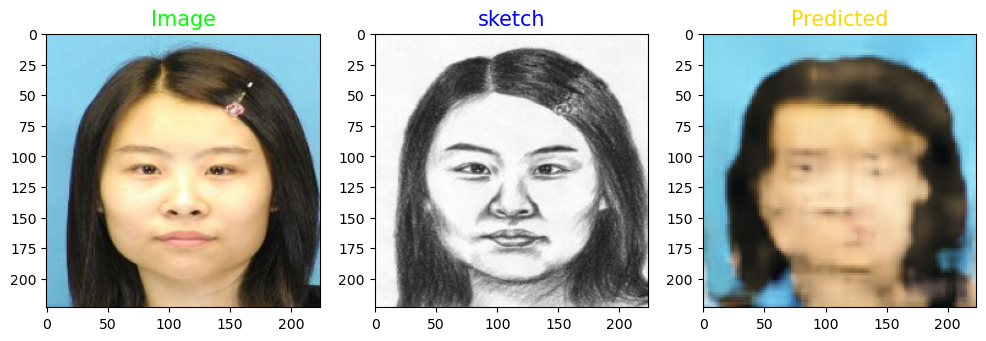

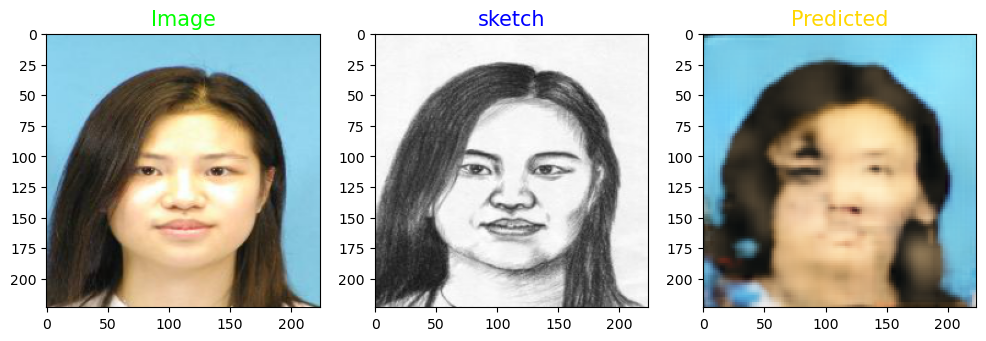

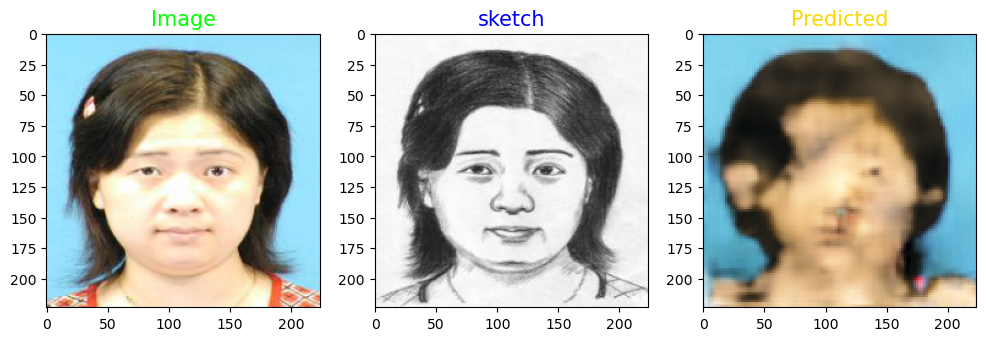

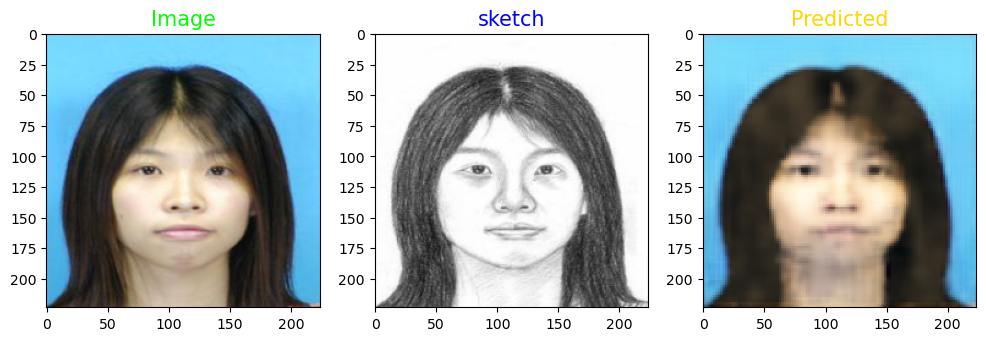

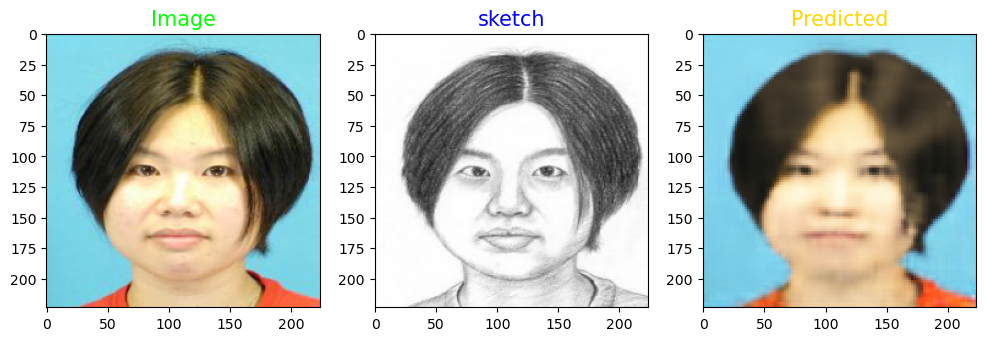

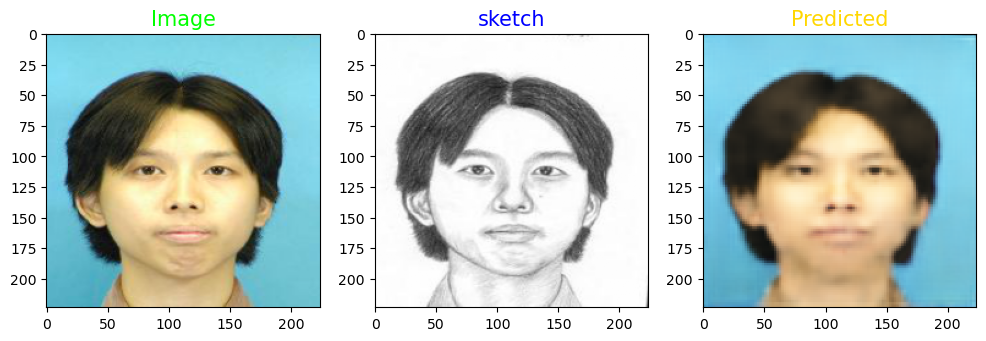

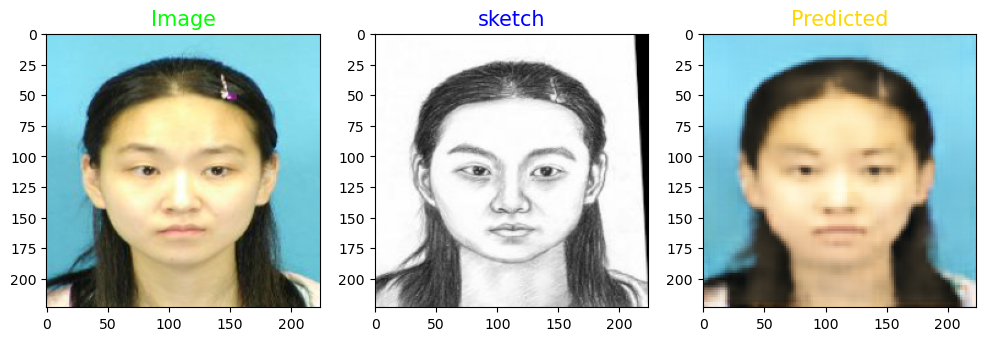

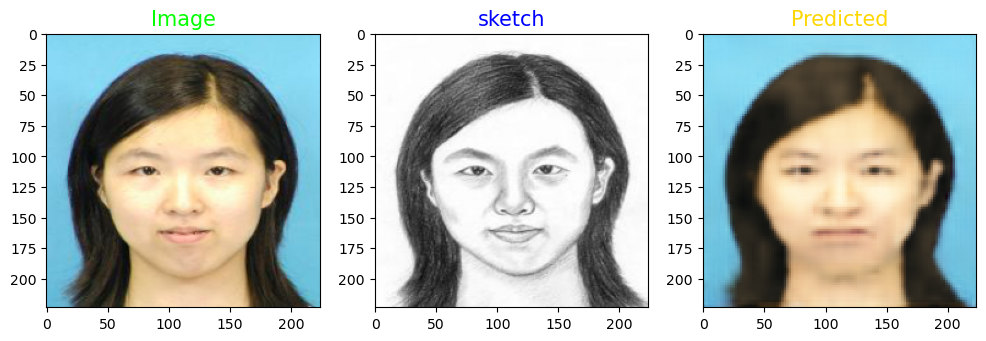

In [119]:
############################################
def show_images(real,sketch, predicted):
    plt.figure(figsize = (12,12))
    plt.subplot(1,3,1)
    plt.title("Image",fontsize = 15, color = 'Lime')
    plt.imshow(real)
    plt.subplot(1,3,2)
    plt.title("sketch",fontsize = 15, color = 'Blue')
    plt.imshow(sketch)
    plt.subplot(1,3,3)
    plt.title("Predicted",fontsize = 15, color = 'gold')
    plt.imshow(predicted)

#Predicting using saved model.
model = tf.keras.models.load_model('vgg16_test_models/VGG16_09000.model',
                                   custom_objects=None,
                                   compile=True)

testpath = 'CUHK Dataset/CUHK_testing_cropped_sketches/'

files = sorted_alphanumeric(os.listdir(testpath))

print("Test images:")
for i in range(5):
    test_sketch_sample = test_sketch[i].reshape((1,224,224,3))
    vggpred = newmodel.predict(test_sketch_sample)
    sample_pred = model.predict(vggpred).reshape((224,224,3))
    
    show_images(test_image[i],test_sketch[i],sample_pred)
print("Train images:")
for i in range(0,40,8):
    test_sketch_sample = train_sketch[i].reshape((1,224,224,3))
    vggpred = newmodel.predict(test_sketch_sample)
    sample_pred = model.predict(vggpred).reshape((224,224,3))
    
    show_images(train_image[i],train_sketch[i],sample_pred)
    
    

Poor generalization but decent on training data.

In [9]:

#Decoder with dropout and regulization
model2 = Sequential()
from keras.regularizers import l2



model2.add(Conv2D(256, (3,3), activation='relu', padding='same', input_shape=(7,7,512), kernel_regularizer=l2(0.01)))
model2.add(tf.keras.layers.Dropout(0.01))
model2.add(Conv2D(128, (3,3), activation='relu', padding='same'))
model2.add(UpSampling2D((2, 2)))
model2.add(Conv2D(64, (3,3), activation='relu', padding='same'))
model2.add(tf.keras.layers.Dropout(0.01))
model2.add(UpSampling2D((2, 2)))
model2.add(Conv2D(32, (3,3), activation='relu', padding='same'))
model2.add(UpSampling2D((2, 2)))
model2.add(Conv2D(16, (3,3), activation='relu', padding='same'))
model2.add(UpSampling2D((2, 2)))
#changed to 3
model2.add(Conv2D(3, (3, 3), activation='tanh', padding='same'))
model2.add(UpSampling2D((2, 2)))



model2.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 7, 7, 256)         1179904   
                                                                 
 dropout_2 (Dropout)         (None, 7, 7, 256)         0         
                                                                 
 conv2d_7 (Conv2D)           (None, 7, 7, 128)         295040    
                                                                 
 up_sampling2d_5 (UpSampling  (None, 14, 14, 128)      0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 14, 14, 64)        73792     
                                                                 
 dropout_3 (Dropout)         (None, 14, 14, 64)        0         
                                                      

Epoch 1/10000
5/5 [==============================] - 4s 763ms/step - loss: 3.3186 - accuracy: 0.1274 - val_loss: 2.4895 - val_accuracy: 0.0383
Epoch 2/10000
5/5 [==============================] - 3s 698ms/step - loss: 2.1543 - accuracy: 0.0506 - val_loss: 1.5987 - val_accuracy: 0.0389
Epoch 3/10000
5/5 [==============================] - 3s 707ms/step - loss: 1.3953 - accuracy: 0.0562 - val_loss: 1.0541 - val_accuracy: 0.0459
Epoch 4/10000
5/5 [==============================] - 4s 723ms/step - loss: 0.9260 - accuracy: 0.0629 - val_loss: 0.7017 - val_accuracy: 0.0648
Epoch 5/10000
5/5 [==============================] - 3s 694ms/step - loss: 0.6381 - accuracy: 0.1711 - val_loss: 0.4949 - val_accuracy: 0.5134
Epoch 6/10000
5/5 [==============================] - 4s 718ms/step - loss: 0.4605 - accuracy: 0.4985 - val_loss: 0.3335 - val_accuracy: 0.4044
Epoch 7/10000
5/5 [==============================] - 3s 689ms/step - loss: 0.3203 - accuracy: 0.4628 - val_loss: 0.2570 - val_accuracy: 0.5122

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_01000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_01000.model/assets


5/5 [==============================] - 4s 910ms/step - loss: 0.0128 - accuracy: 0.9058 - val_loss: 0.0207 - val_accuracy: 0.9099
Epoch 1001/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0130 - accuracy: 0.9061 - val_loss: 0.0213 - val_accuracy: 0.9091
Epoch 1002/10000
5/5 [==============================] - 3s 702ms/step - loss: 0.0126 - accuracy: 0.9059 - val_loss: 0.0209 - val_accuracy: 0.9094
Epoch 1003/10000
5/5 [==============================] - 4s 720ms/step - loss: 0.0128 - accuracy: 0.9060 - val_loss: 0.0212 - val_accuracy: 0.9092
Epoch 1004/10000
5/5 [==============================] - 3s 701ms/step - loss: 0.0129 - accuracy: 0.9056 - val_loss: 0.0205 - val_accuracy: 0.9091
Epoch 1005/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0126 - accuracy: 0.9055 - val_loss: 0.0207 - val_accuracy: 0.9090
Epoch 1006/10000
5/5 [==============================] - 3s 696ms/step - loss: 0.0128 - accuracy: 0.9049 - val_loss: 0.0207 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_02000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_02000.model/assets


5/5 [==============================] - 4s 937ms/step - loss: 0.0127 - accuracy: 0.9093 - val_loss: 0.0218 - val_accuracy: 0.9080
Epoch 2001/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0123 - accuracy: 0.9085 - val_loss: 0.0215 - val_accuracy: 0.9094
Epoch 2002/10000
5/5 [==============================] - 4s 709ms/step - loss: 0.0117 - accuracy: 0.9091 - val_loss: 0.0210 - val_accuracy: 0.9100
Epoch 2003/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0110 - accuracy: 0.9113 - val_loss: 0.0205 - val_accuracy: 0.9106
Epoch 2004/10000
5/5 [==============================] - 3s 698ms/step - loss: 0.0106 - accuracy: 0.9115 - val_loss: 0.0209 - val_accuracy: 0.9125
Epoch 2005/10000
5/5 [==============================] - 3s 698ms/step - loss: 0.0104 - accuracy: 0.9129 - val_loss: 0.0207 - val_accuracy: 0.9131
Epoch 2006/10000
5/5 [==============================] - 4s 727ms/step - loss: 0.0099 - accuracy: 0.9137 - val_loss: 0.0205 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_03000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_03000.model/assets


5/5 [==============================] - 4s 908ms/step - loss: 0.0090 - accuracy: 0.9178 - val_loss: 0.0209 - val_accuracy: 0.9136
Epoch 3001/10000
5/5 [==============================] - 4s 707ms/step - loss: 0.0092 - accuracy: 0.9172 - val_loss: 0.0210 - val_accuracy: 0.9135
Epoch 3002/10000
5/5 [==============================] - 4s 704ms/step - loss: 0.0091 - accuracy: 0.9170 - val_loss: 0.0205 - val_accuracy: 0.9142
Epoch 3003/10000
5/5 [==============================] - 3s 701ms/step - loss: 0.0090 - accuracy: 0.9180 - val_loss: 0.0213 - val_accuracy: 0.9113
Epoch 3004/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0094 - accuracy: 0.9168 - val_loss: 0.0215 - val_accuracy: 0.9129
Epoch 3005/10000
5/5 [==============================] - 3s 694ms/step - loss: 0.0100 - accuracy: 0.9152 - val_loss: 0.0211 - val_accuracy: 0.9113
Epoch 3006/10000
5/5 [==============================] - 4s 716ms/step - loss: 0.0102 - accuracy: 0.9153 - val_loss: 0.0208 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_04000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_04000.model/assets


5/5 [==============================] - 4s 916ms/step - loss: 0.0085 - accuracy: 0.9189 - val_loss: 0.0207 - val_accuracy: 0.9139
Epoch 4001/10000
5/5 [==============================] - 3s 693ms/step - loss: 0.0084 - accuracy: 0.9192 - val_loss: 0.0211 - val_accuracy: 0.9128
Epoch 4002/10000
5/5 [==============================] - 3s 693ms/step - loss: 0.0087 - accuracy: 0.9185 - val_loss: 0.0210 - val_accuracy: 0.9134
Epoch 4003/10000
5/5 [==============================] - 3s 696ms/step - loss: 0.0085 - accuracy: 0.9199 - val_loss: 0.0209 - val_accuracy: 0.9137
Epoch 4004/10000
5/5 [==============================] - 4s 711ms/step - loss: 0.0085 - accuracy: 0.9190 - val_loss: 0.0210 - val_accuracy: 0.9136
Epoch 4005/10000
5/5 [==============================] - 3s 688ms/step - loss: 0.0084 - accuracy: 0.9193 - val_loss: 0.0210 - val_accuracy: 0.9135
Epoch 4006/10000
5/5 [==============================] - 3s 689ms/step - loss: 0.0086 - accuracy: 0.9186 - val_loss: 0.0212 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_05000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_05000.model/assets


5/5 [==============================] - 4s 931ms/step - loss: 0.0080 - accuracy: 0.9184 - val_loss: 0.0212 - val_accuracy: 0.9122
Epoch 5001/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0078 - accuracy: 0.9194 - val_loss: 0.0210 - val_accuracy: 0.9130
Epoch 5002/10000
5/5 [==============================] - 3s 704ms/step - loss: 0.0078 - accuracy: 0.9197 - val_loss: 0.0210 - val_accuracy: 0.9131
Epoch 5003/10000
5/5 [==============================] - 3s 697ms/step - loss: 0.0085 - accuracy: 0.9183 - val_loss: 0.0232 - val_accuracy: 0.9101
Epoch 5004/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0106 - accuracy: 0.9137 - val_loss: 0.0239 - val_accuracy: 0.8994
Epoch 5005/10000
5/5 [==============================] - 4s 719ms/step - loss: 0.0124 - accuracy: 0.9077 - val_loss: 0.0229 - val_accuracy: 0.9059
Epoch 5006/10000
5/5 [==============================] - 3s 696ms/step - loss: 0.0110 - accuracy: 0.9125 - val_loss: 0.0219 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_06000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_06000.model/assets


5/5 [==============================] - 5s 970ms/step - loss: 0.0104 - accuracy: 0.9116 - val_loss: 0.0228 - val_accuracy: 0.9058
Epoch 6001/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0100 - accuracy: 0.9131 - val_loss: 0.0217 - val_accuracy: 0.9112
Epoch 6002/10000
5/5 [==============================] - 3s 695ms/step - loss: 0.0091 - accuracy: 0.9157 - val_loss: 0.0217 - val_accuracy: 0.9107
Epoch 6003/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0090 - accuracy: 0.9154 - val_loss: 0.0217 - val_accuracy: 0.9086
Epoch 6004/10000
5/5 [==============================] - 3s 705ms/step - loss: 0.0086 - accuracy: 0.9153 - val_loss: 0.0211 - val_accuracy: 0.9120
Epoch 6005/10000
5/5 [==============================] - 4s 714ms/step - loss: 0.0083 - accuracy: 0.9164 - val_loss: 0.0216 - val_accuracy: 0.9087
Epoch 6006/10000
5/5 [==============================] - 3s 698ms/step - loss: 0.0081 - accuracy: 0.9169 - val_loss: 0.0210 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_07000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_07000.model/assets


5/5 [==============================] - 4s 926ms/step - loss: 0.0082 - accuracy: 0.9171 - val_loss: 0.0214 - val_accuracy: 0.9112
Epoch 7001/10000
5/5 [==============================] - 4s 702ms/step - loss: 0.0078 - accuracy: 0.9180 - val_loss: 0.0215 - val_accuracy: 0.9110
Epoch 7002/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0077 - accuracy: 0.9180 - val_loss: 0.0210 - val_accuracy: 0.9099
Epoch 7003/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0076 - accuracy: 0.9189 - val_loss: 0.0212 - val_accuracy: 0.9110
Epoch 7004/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0076 - accuracy: 0.9192 - val_loss: 0.0211 - val_accuracy: 0.9123
Epoch 7005/10000
5/5 [==============================] - 4s 723ms/step - loss: 0.0075 - accuracy: 0.9191 - val_loss: 0.0213 - val_accuracy: 0.9109
Epoch 7006/10000
5/5 [==============================] - 3s 696ms/step - loss: 0.0078 - accuracy: 0.9193 - val_loss: 0.0213 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_08000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_08000.model/assets


5/5 [==============================] - 4s 935ms/step - loss: 0.0088 - accuracy: 0.9162 - val_loss: 0.0220 - val_accuracy: 0.9104
Epoch 8001/10000
5/5 [==============================] - 3s 701ms/step - loss: 0.0084 - accuracy: 0.9161 - val_loss: 0.0221 - val_accuracy: 0.9089
Epoch 8002/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0080 - accuracy: 0.9164 - val_loss: 0.0216 - val_accuracy: 0.9081
Epoch 8003/10000
5/5 [==============================] - 3s 695ms/step - loss: 0.0077 - accuracy: 0.9169 - val_loss: 0.0212 - val_accuracy: 0.9084
Epoch 8004/10000
5/5 [==============================] - 3s 697ms/step - loss: 0.0075 - accuracy: 0.9179 - val_loss: 0.0210 - val_accuracy: 0.9118
Epoch 8005/10000
5/5 [==============================] - 4s 710ms/step - loss: 0.0073 - accuracy: 0.9191 - val_loss: 0.0211 - val_accuracy: 0.9104
Epoch 8006/10000
5/5 [==============================] - 3s 695ms/step - loss: 0.0073 - accuracy: 0.9191 - val_loss: 0.0212 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_09000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_09000.model/assets


5/5 [==============================] - 5s 971ms/step - loss: 0.0084 - accuracy: 0.9155 - val_loss: 0.0218 - val_accuracy: 0.9096
Epoch 9001/10000
5/5 [==============================] - 3s 692ms/step - loss: 0.0079 - accuracy: 0.9171 - val_loss: 0.0213 - val_accuracy: 0.9085
Epoch 9002/10000
5/5 [==============================] - 3s 700ms/step - loss: 0.0077 - accuracy: 0.9166 - val_loss: 0.0212 - val_accuracy: 0.9085
Epoch 9003/10000
5/5 [==============================] - 3s 699ms/step - loss: 0.0075 - accuracy: 0.9176 - val_loss: 0.0214 - val_accuracy: 0.9104
Epoch 9004/10000
5/5 [==============================] - 4s 721ms/step - loss: 0.0075 - accuracy: 0.9188 - val_loss: 0.0213 - val_accuracy: 0.9095
Epoch 9005/10000
5/5 [==============================] - 3s 695ms/step - loss: 0.0073 - accuracy: 0.9196 - val_loss: 0.0210 - val_accuracy: 0.9107
Epoch 9006/10000
5/5 [==============================] - 3s 696ms/step - loss: 0.0073 - accuracy: 0.9204 - val_loss: 0.0212 - val_accuracy: 0.

INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_10000.model/assets


INFO:tensorflow:Assets written to: vgg16_dropout_test_models/VGG16_10000.model/assets


5/5 [==============================] - 4s 909ms/step - loss: 0.0077 - accuracy: 0.9184 - val_loss: 0.0218 - val_accuracy: 0.9098


INFO:tensorflow:Assets written to: VGG16_dropout_s2f_generator10000.model/assets


INFO:tensorflow:Assets written to: VGG16_dropout_s2f_generator10000.model/assets


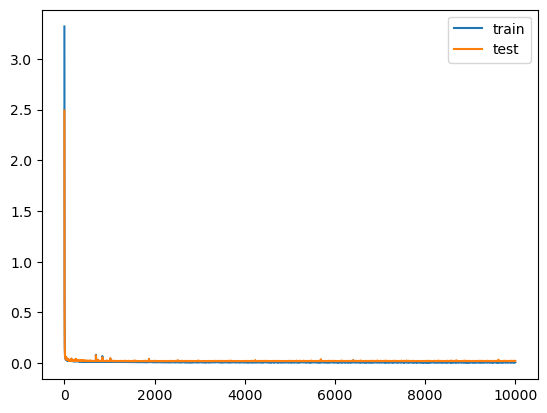

In [10]:

checkpoint = keras.callbacks.ModelCheckpoint('vgg16_dropout_test_models/VGG16_{epoch:05d}.model', period=1000) 
model2.compile(optimizer='Adam', loss='mse' , metrics=['accuracy'])
history = model2.fit(vggfeatures, Y, verbose=1, epochs=10000, validation_split=0.1, batch_size=128, callbacks=[checkpoint])

model2.save('VGG16_dropout_s2f_generator10000.model')
# evaluate the model
#_, train_acc = model.evaluate(np.array(train_sketch), np.array(train_image), verbose=0)
#_, test_acc = model.evaluate(np.array(test_sketch), np.array(test_image), verbose=0)
#print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
# plot training history
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()

Test images:
1/1 [==============================] - 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 21ms/step
Train images:
1/1 [==============================] - 0s 21ms/step


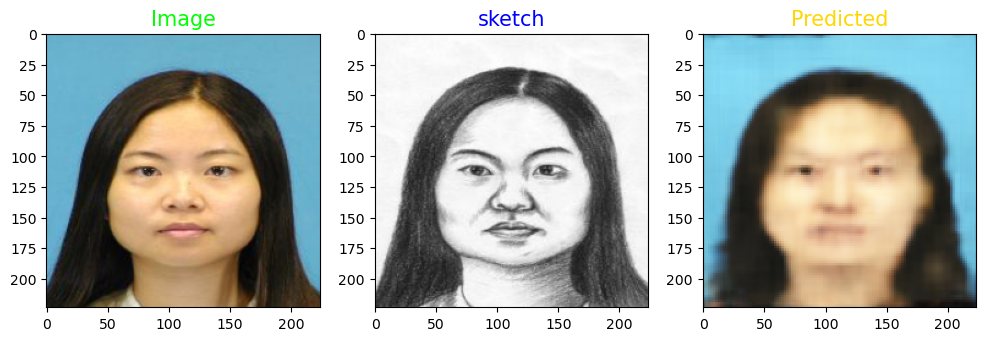

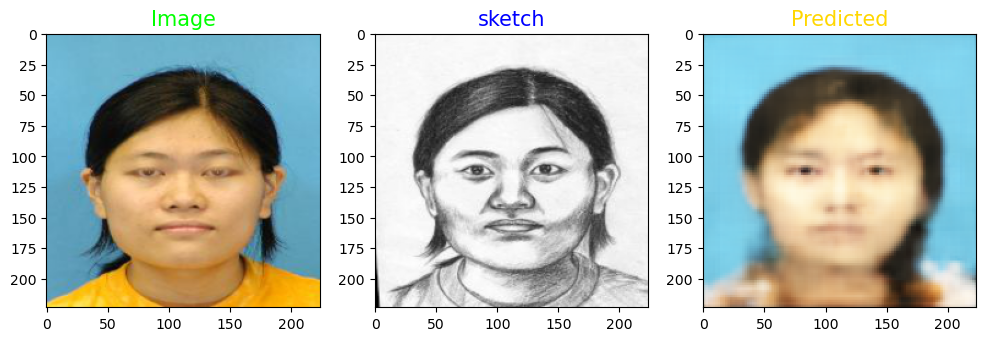

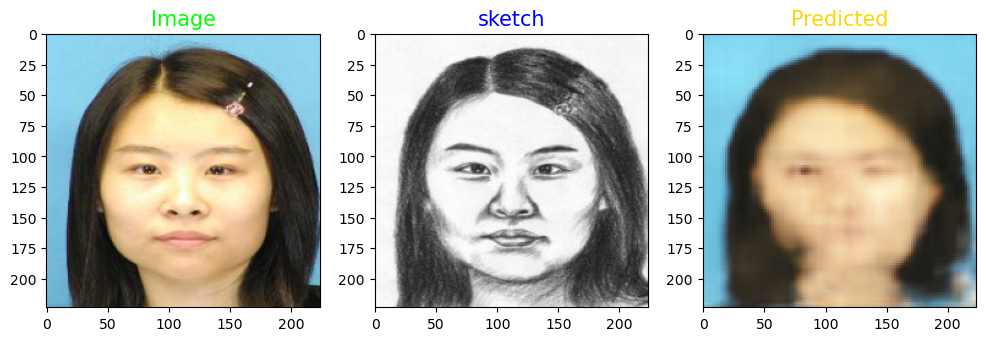

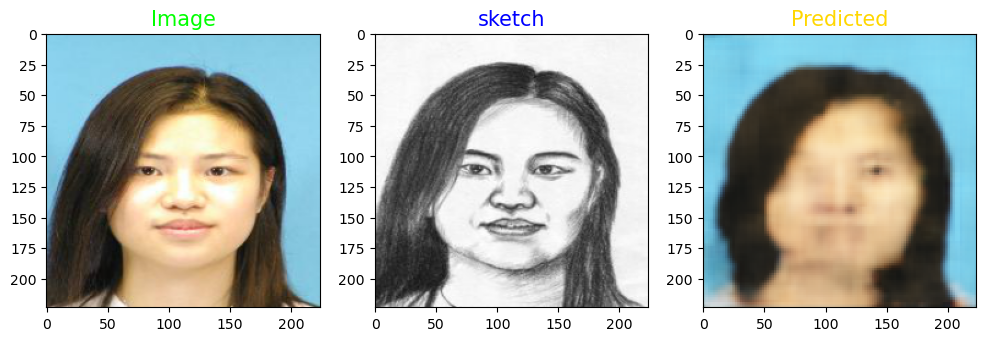

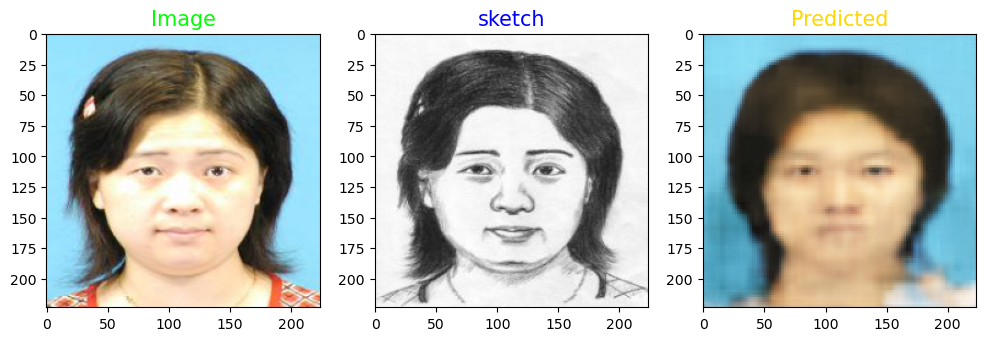

...

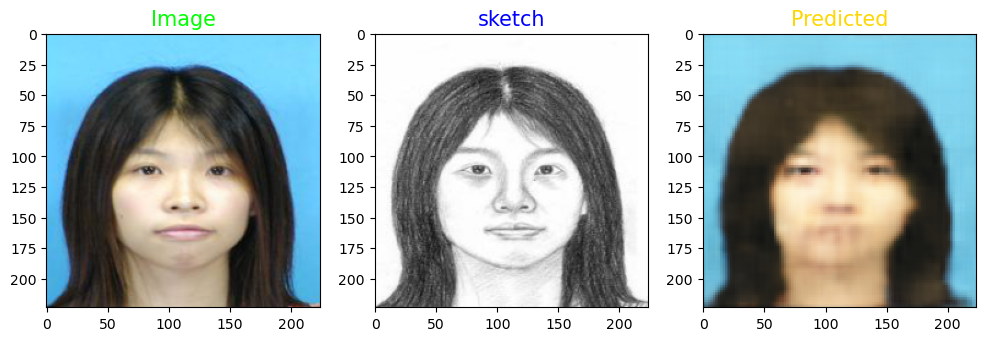

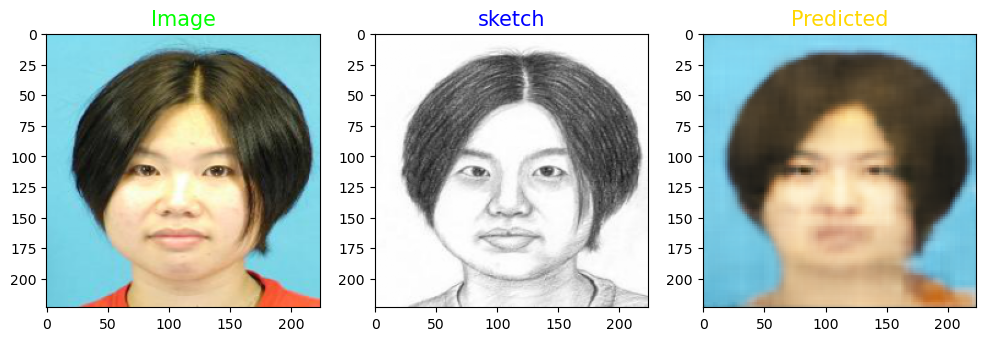

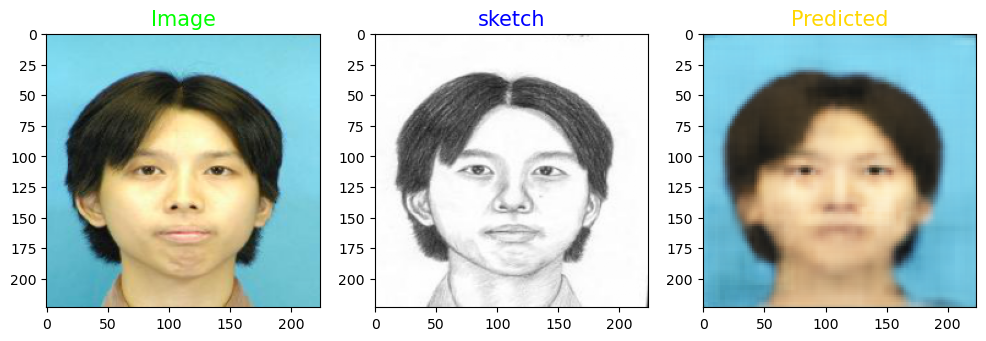

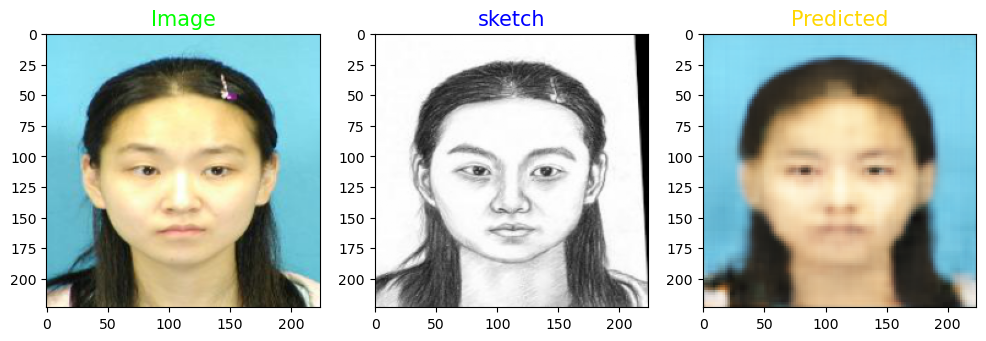

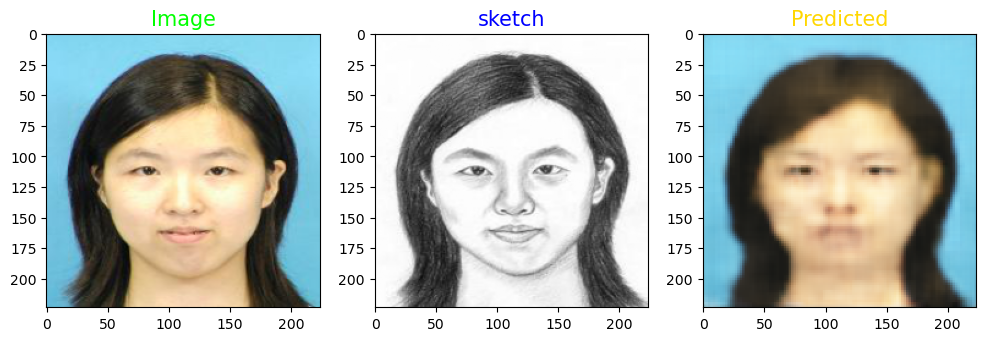

In [8]:
############################################
def show_images(real,sketch, predicted):
    plt.figure(figsize = (12,12))
    plt.subplot(1,3,1)
    plt.title("Image",fontsize = 15, color = 'Lime')
    plt.imshow(real)
    plt.subplot(1,3,2)
    plt.title("sketch",fontsize = 15, color = 'Blue')
    plt.imshow(sketch)
    plt.subplot(1,3,3)
    plt.title("Predicted",fontsize = 15, color = 'gold')
    plt.imshow(predicted)

#Predicting using saved model.
model = tf.keras.models.load_model('vgg16_dropout_test_models/VGG16_10000.model',
                                   custom_objects=None,
                                   compile=True)



print("Test images:")
for i in range(10):
    test_sketch_sample = test_sketch[i].reshape((1,224,224,3))
    vggpred = newmodel.predict(test_sketch_sample)
    sample_pred = model.predict(vggpred).reshape((224,224,3))
    
    show_images(test_image[i],test_sketch[i],sample_pred)
print("Train images:")
for i in range(0,40,8):
    test_sketch_sample = train_sketch[i].reshape((1,224,224,3))
    vggpred = newmodel.predict(test_sketch_sample)
    sample_pred = model.predict(vggpred).reshape((224,224,3))
    
    show_images(train_image[i],train_sketch[i],sample_pred)

In [93]:
#Decoder
model3 = Sequential()
from keras.regularizers import l2



model3.add(Conv2D(256, (3,3), activation='relu', padding='same', input_shape=(7,7,512), kernel_regularizer=l2(0.01)))
model3.add(tf.keras.layers.Dropout(0.1))
model3.add(Conv2D(128, (3,3), activation='relu', padding='same'))
model3.add(tf.keras.layers.Dropout(0.1))
model3.add(UpSampling2D((2, 2)))
model3.add(Conv2D(64, (3,3), activation='relu', padding='same'))
model3.add(tf.keras.layers.Dropout(0.1))
model3.add(UpSampling2D((2, 2)))
model3.add(Conv2D(32, (3,3), activation='relu', padding='same'))
model3.add(tf.keras.layers.Dropout(0.1))
model3.add(UpSampling2D((2, 2)))
model3.add(Conv2D(16, (3,3), activation='relu', padding='same'))
model3.add(tf.keras.layers.Dropout(0.1))
model3.add(UpSampling2D((2, 2)))
#changed to 3
model3.add(Conv2D(3, (3, 3), activation='tanh', padding='same'))
model3.add(tf.keras.layers.Dropout(0.1))
model3.add(UpSampling2D((2, 2)))



model2.summary()

Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_110 (Conv2D)         (None, 7, 7, 256)         1179904   
                                                                 
 dropout_40 (Dropout)        (None, 7, 7, 256)         0         
                                                                 
 conv2d_111 (Conv2D)         (None, 7, 7, 128)         295040    
                                                                 
 up_sampling2d_95 (UpSamplin  (None, 14, 14, 128)      0         
 g2D)                                                            
                                                                 
 conv2d_112 (Conv2D)         (None, 14, 14, 64)        73792     
                                                                 
 dropout_41 (Dropout)        (None, 14, 14, 64)        0         
                                                     

Epoch 1/1000
5/5 [==============================] - 4s 768ms/step - loss: 3.1753 - accuracy: 0.3726 - val_loss: 2.2741 - val_accuracy: 0.1259
Epoch 2/1000
5/5 [==============================] - 4s 768ms/step - loss: 1.9292 - accuracy: 0.3442 - val_loss: 1.3472 - val_accuracy: 0.5423
Epoch 3/1000
5/5 [==============================] - 4s 746ms/step - loss: 1.1289 - accuracy: 0.3765 - val_loss: 0.7738 - val_accuracy: 0.4831
Epoch 4/1000
5/5 [==============================] - 4s 751ms/step - loss: 0.6446 - accuracy: 0.4271 - val_loss: 0.4258 - val_accuracy: 0.6731
Epoch 5/1000
5/5 [==============================] - 4s 774ms/step - loss: 0.3801 - accuracy: 0.4928 - val_loss: 0.2513 - val_accuracy: 0.7016
Epoch 6/1000
5/5 [==============================] - 4s 787ms/step - loss: 0.2501 - accuracy: 0.5162 - val_loss: 0.1679 - val_accuracy: 0.7373
Epoch 7/1000
5/5 [==============================] - 4s 726ms/step - loss: 0.1890 - accuracy: 0.5567 - val_loss: 0.1226 - val_accuracy: 0.7705
Epoch 

INFO:tensorflow:Assets written to: VGG16_dropout2_s2f_generator.model/assets


INFO:tensorflow:Assets written to: VGG16_dropout2_s2f_generator.model/assets


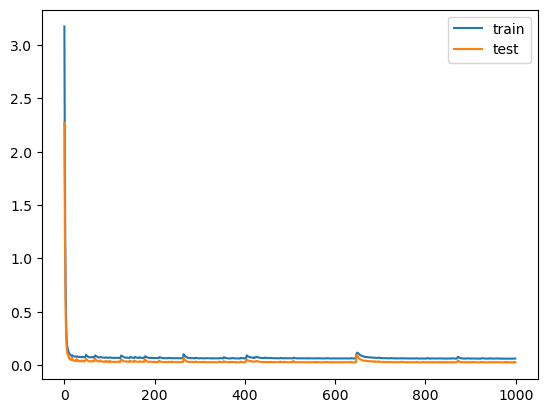

In [94]:

model3.compile(optimizer='Adam', loss='mse' , metrics=['accuracy'])
history = model3.fit(vggfeatures, Y, verbose=1, epochs=1000, validation_split=0.1,batch_size=128)

model2.save('VGG16_dropout2_s2f_generator.model')
# evaluate the model
#_, train_acc = model.evaluate(np.array(train_sketch), np.array(train_image), verbose=0)
#_, test_acc = model.evaluate(np.array(test_sketch), np.array(test_image), verbose=0)
#print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
# plot training history
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()

Test images:
1/1 [==============================] - 0s 25ms/step
Train images:
1/1 [==============================] - 0s 24ms/step


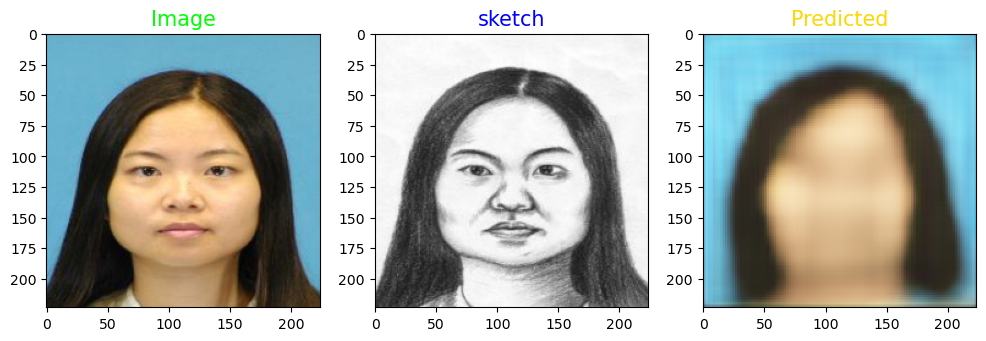

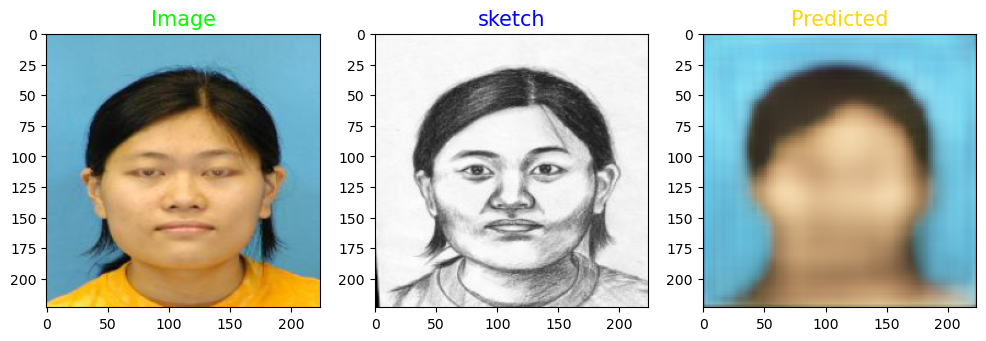

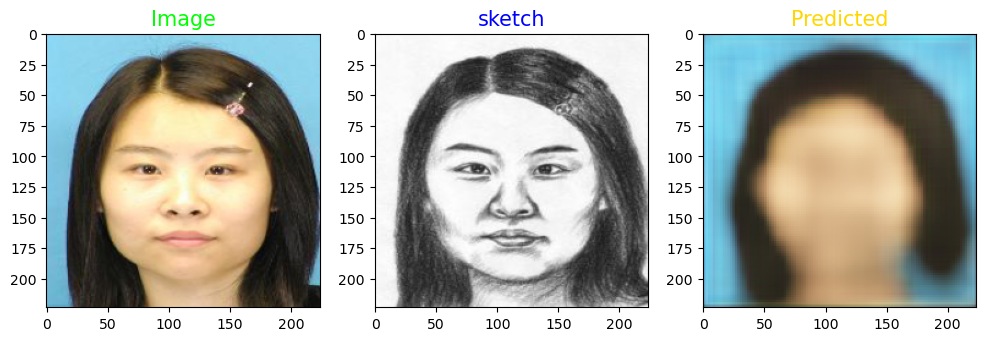

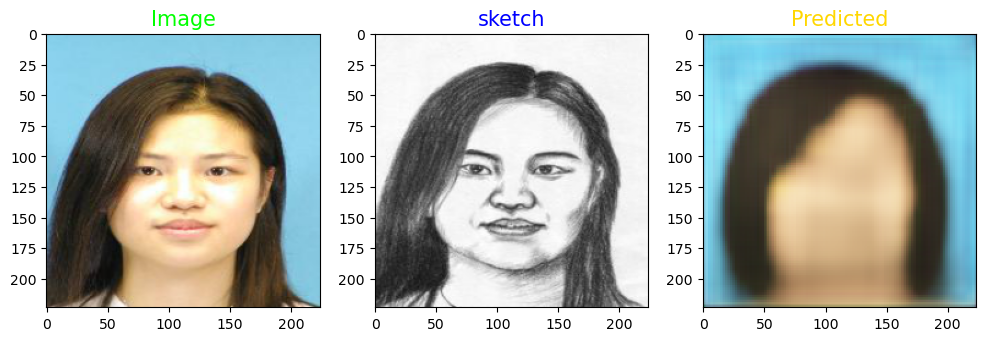

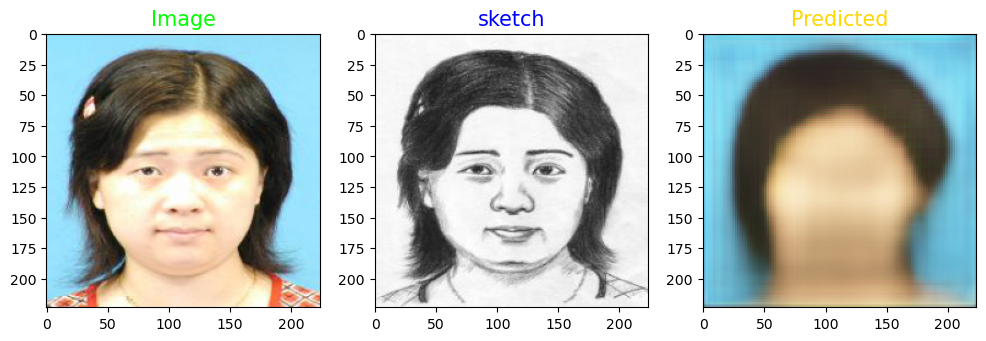

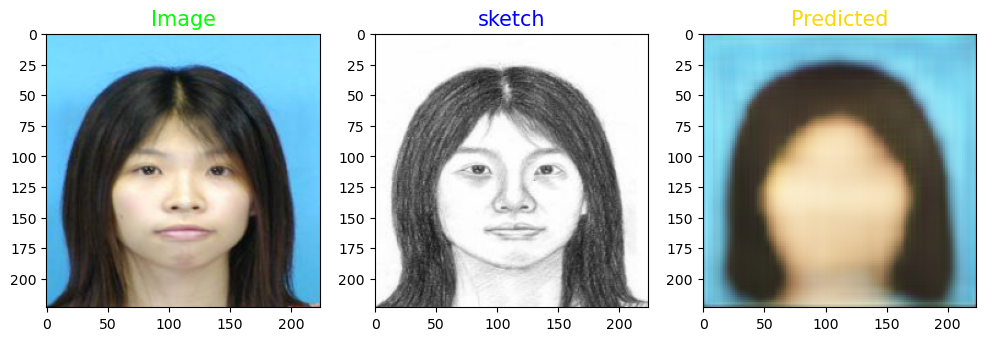

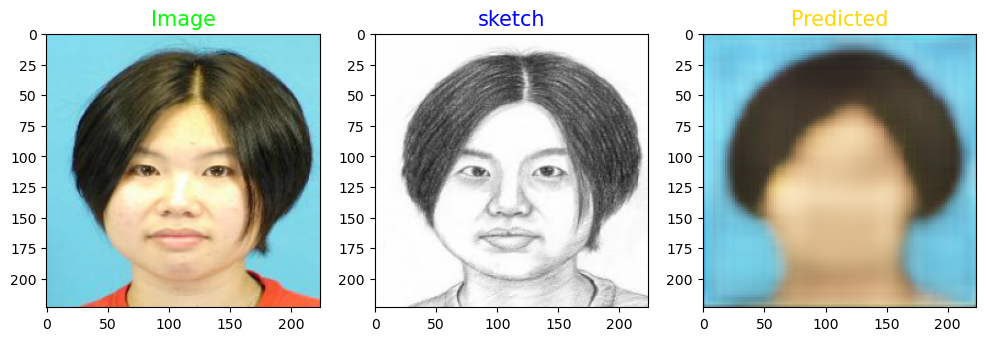

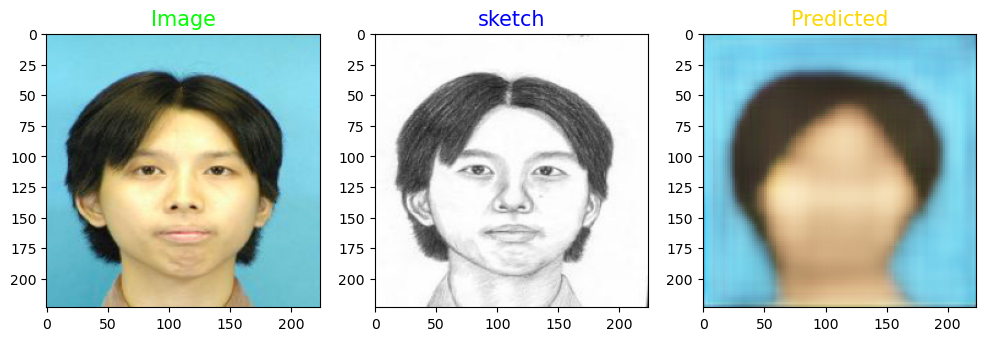

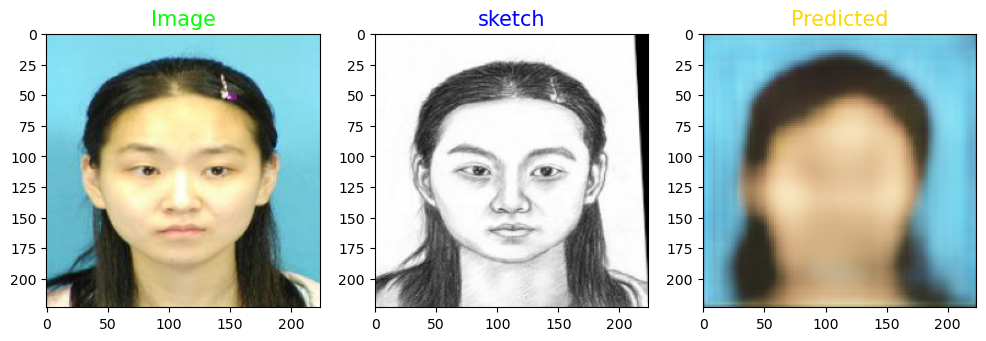

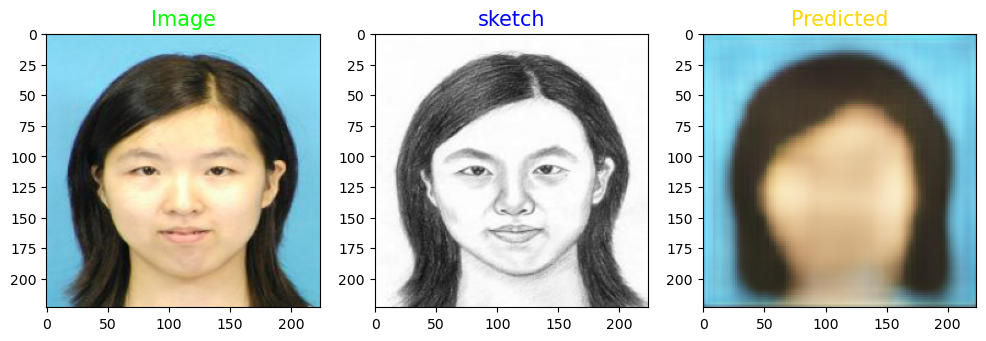

In [95]:
############################################
def show_images(real,sketch, predicted):
    plt.figure(figsize = (12,12))
    plt.subplot(1,3,1)
    plt.title("Image",fontsize = 15, color = 'Lime')
    plt.imshow(real)
    plt.subplot(1,3,2)
    plt.title("sketch",fontsize = 15, color = 'Blue')
    plt.imshow(sketch)
    plt.subplot(1,3,3)
    plt.title("Predicted",fontsize = 15, color = 'gold')
    plt.imshow(predicted)

#Predicting using saved model.
model = tf.keras.models.load_model('VGG16_dropout2_s2f_generator.model',
                                   custom_objects=None,
                                   compile=True)

testpath = 'CUHK Dataset/CUHK_testing_cropped_sketches/'

files = sorted_alphanumeric(os.listdir(testpath))

print("Test images:")
for i in range(5):
    test_sketch_sample = test_sketch[i].reshape((1,224,224,3))
    vggpred = newmodel.predict(test_sketch_sample)
    sample_pred = model.predict(vggpred).reshape((224,224,3))
    
    show_images(test_image[i],test_sketch[i],sample_pred)
print("Train images:")
for i in range(0,40,8):
    test_sketch_sample = train_sketch[i].reshape((1,224,224,3))
    vggpred = newmodel.predict(test_sketch_sample)
    sample_pred = model.predict(vggpred).reshape((224,224,3))
    
    show_images(train_image[i],train_sketch[i],sample_pred)

Try with less dropout (one in higher layers where impact is not as high with more neurons). dropout of 0.1 from paper recommendation. 

In [98]:
#Decoder
model4 = Sequential()
from keras.regularizers import l2



model4.add(Conv2D(256, (3,3), activation='relu', padding='same', input_shape=(7,7,512), kernel_regularizer=l2(0.01)))
model4.add(tf.keras.layers.Dropout(0.1))
model4.add(Conv2D(128, (3,3), activation='relu', padding='same'))
model4.add(UpSampling2D((2, 2)))
model4.add(Conv2D(64, (3,3), activation='relu', padding='same'))
model4.add(UpSampling2D((2, 2)))
model4.add(Conv2D(32, (3,3), activation='relu', padding='same'))
model4.add(UpSampling2D((2, 2)))
model4.add(Conv2D(16, (3,3), activation='relu', padding='same'))
model4.add(UpSampling2D((2, 2)))
#chaned to 3
model4.add(Conv2D(3, (3, 3), activation='tanh', padding='same'))
model4.add(UpSampling2D((2, 2)))



model4.summary()

Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_134 (Conv2D)         (None, 7, 7, 256)         1179904   
                                                                 
 dropout_55 (Dropout)        (None, 7, 7, 256)         0         
                                                                 
 conv2d_135 (Conv2D)         (None, 7, 7, 128)         295040    
                                                                 
 up_sampling2d_115 (UpSampli  (None, 14, 14, 128)      0         
 ng2D)                                                           
                                                                 
 conv2d_136 (Conv2D)         (None, 14, 14, 64)        73792     
                                                                 
 up_sampling2d_116 (UpSampli  (None, 28, 28, 64)       0         
 ng2D)                                               

Epoch 1/1000
5/5 [==============================] - 4s 752ms/step - loss: 3.2862 - accuracy: 0.3739 - val_loss: 2.4743 - val_accuracy: 0.4111
Epoch 2/1000
5/5 [==============================] - 4s 723ms/step - loss: 2.1273 - accuracy: 0.2800 - val_loss: 1.6040 - val_accuracy: 0.1928
Epoch 3/1000
5/5 [==============================] - 4s 732ms/step - loss: 1.3860 - accuracy: 0.4840 - val_loss: 1.0385 - val_accuracy: 0.6829
Epoch 4/1000
5/5 [==============================] - 4s 727ms/step - loss: 0.9093 - accuracy: 0.6550 - val_loss: 0.6918 - val_accuracy: 0.6048
Epoch 5/1000
5/5 [==============================] - 4s 722ms/step - loss: 0.6299 - accuracy: 0.6036 - val_loss: 0.5004 - val_accuracy: 0.5853
Epoch 6/1000
5/5 [==============================] - 4s 722ms/step - loss: 0.4791 - accuracy: 0.5930 - val_loss: 0.4001 - val_accuracy: 0.5863
Epoch 7/1000
5/5 [==============================] - 4s 723ms/step - loss: 0.3999 - accuracy: 0.6011 - val_loss: 0.3455 - val_accuracy: 0.6099
Epoch 

INFO:tensorflow:Assets written to: VGG16_dropout3_s2f_generator.model/assets


INFO:tensorflow:Assets written to: VGG16_dropout3_s2f_generator.model/assets


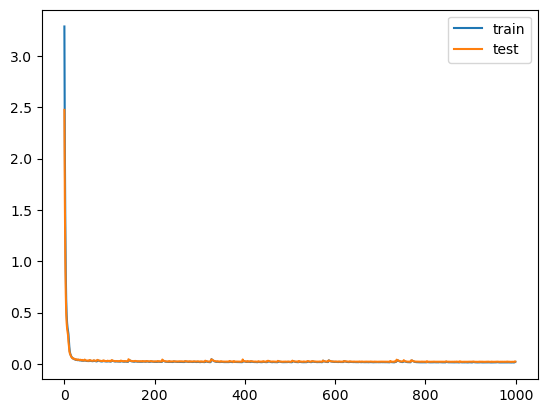

In [99]:

model4.compile(optimizer='Adam', loss='mse' , metrics=['accuracy'])
history = model4.fit(vggfeatures, Y, verbose=1, epochs=1000, validation_split=0.1,batch_size=128)

model4.save('VGG16_dropout3_s2f_generator.model')
# evaluate the model
#_, train_acc = model.evaluate(np.array(train_sketch), np.array(train_image), verbose=0)
#_, test_acc = model.evaluate(np.array(test_sketch), np.array(test_image), verbose=0)
#print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
# plot training history
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()

Test images:
1/1 [==============================] - 0s 26ms/step
Train images:
1/1 [==============================] - 0s 24ms/step


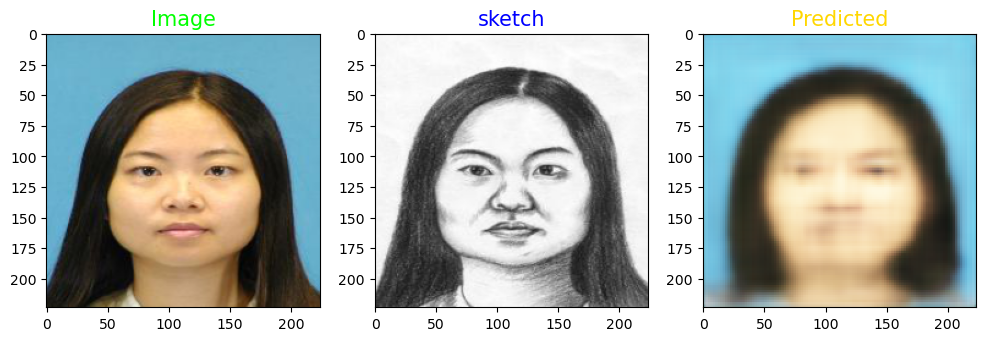

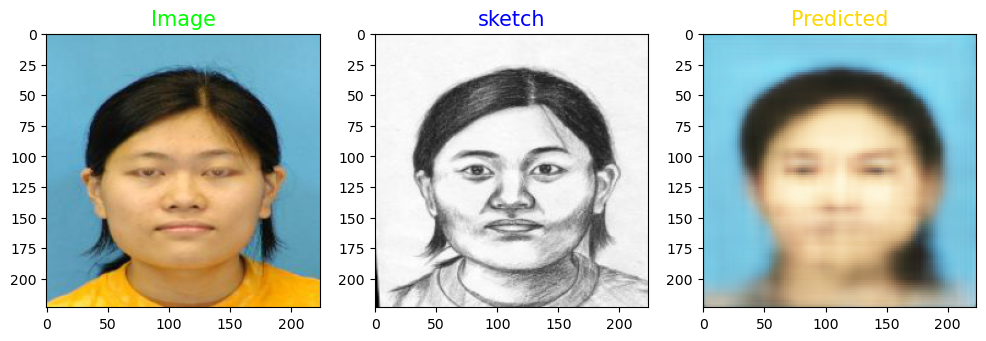

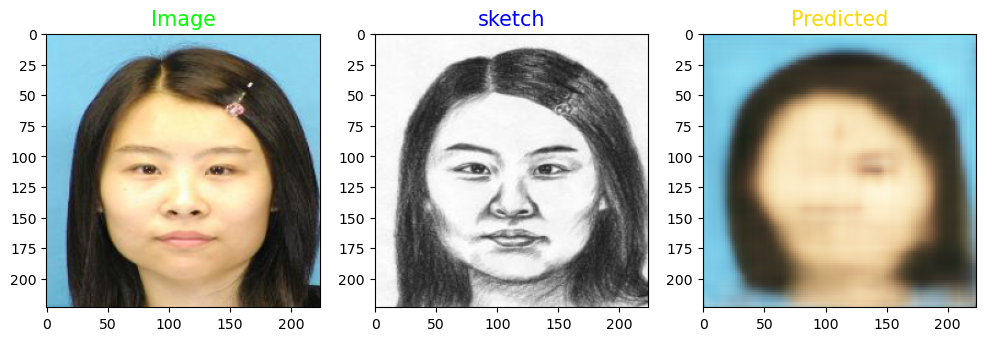

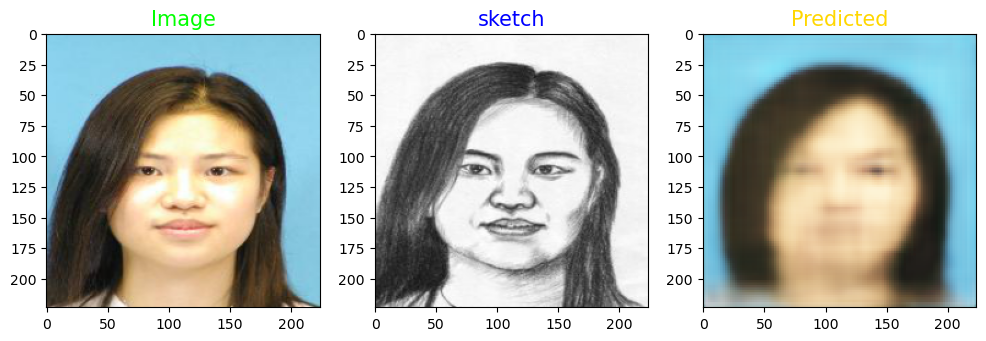

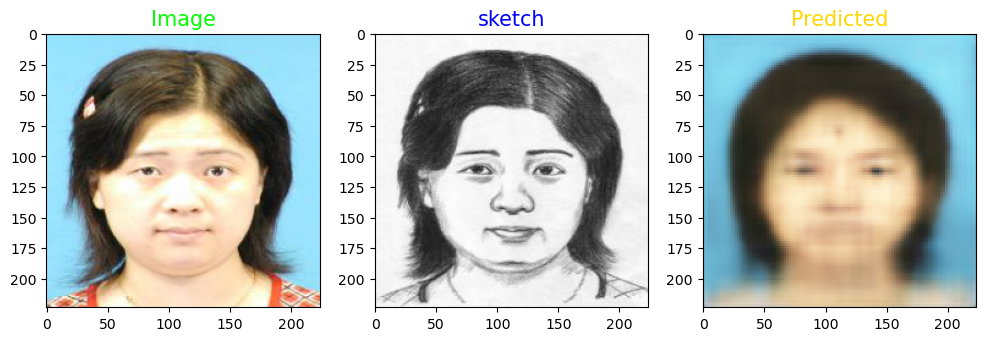

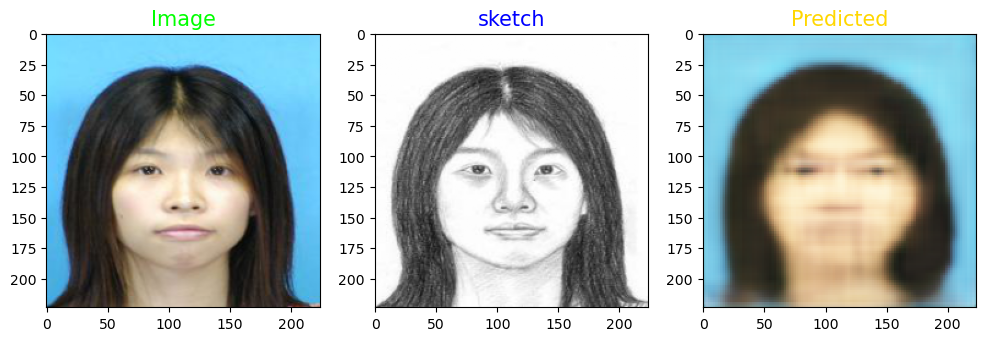

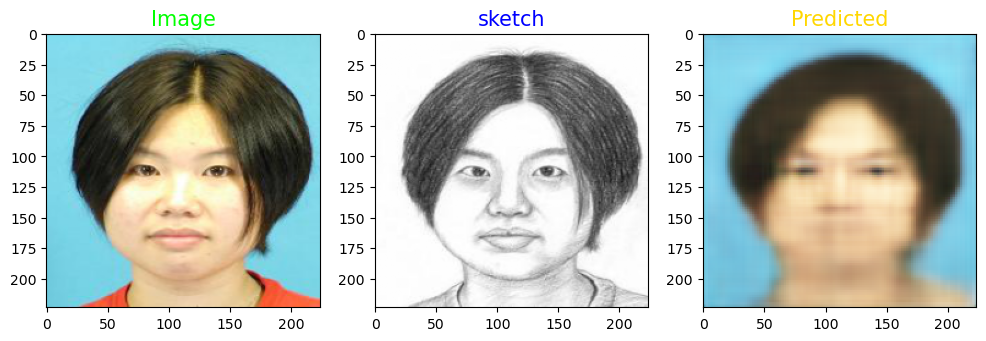

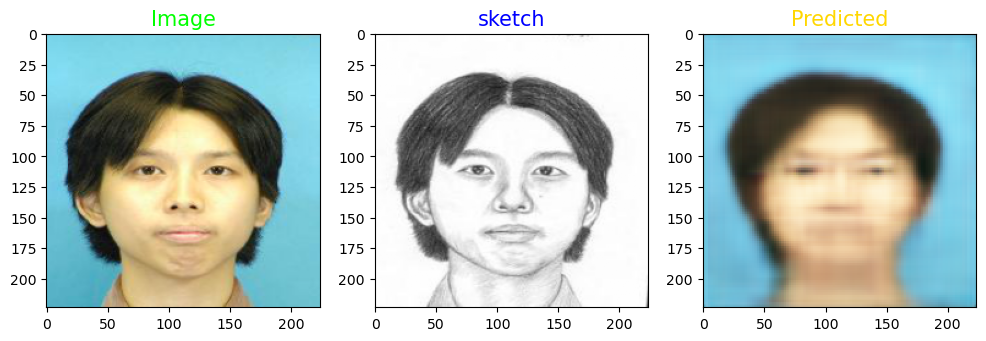

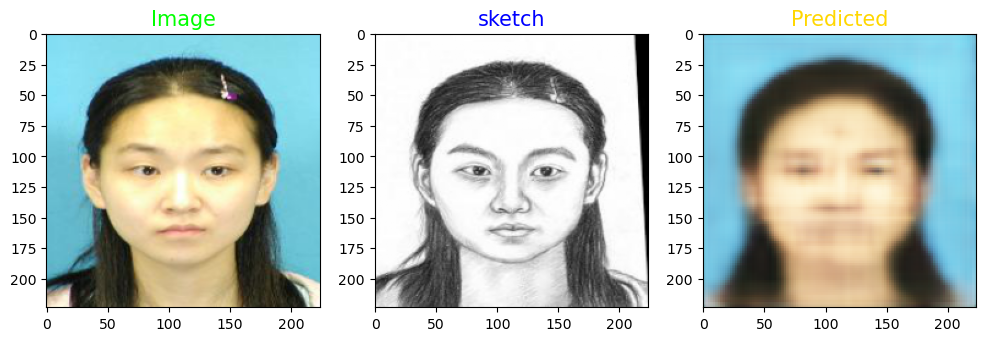

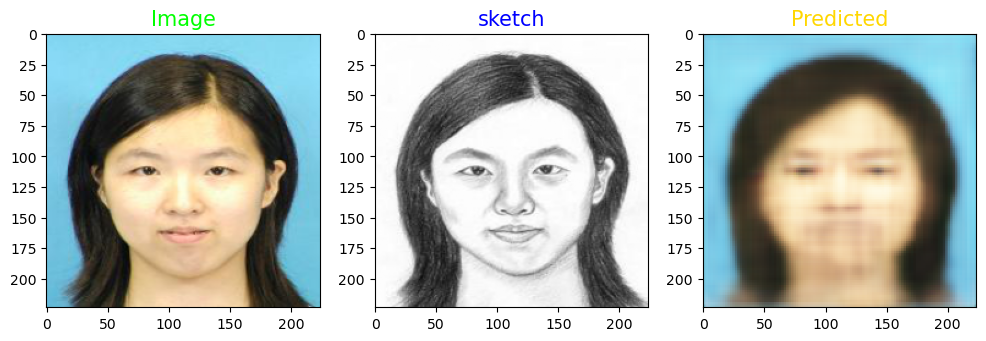

In [100]:
############################################
def show_images(real,sketch, predicted):
    plt.figure(figsize = (12,12))
    plt.subplot(1,3,1)
    plt.title("Image",fontsize = 15, color = 'Lime')
    plt.imshow(real)
    plt.subplot(1,3,2)
    plt.title("sketch",fontsize = 15, color = 'Blue')
    plt.imshow(sketch)
    plt.subplot(1,3,3)
    plt.title("Predicted",fontsize = 15, color = 'gold')
    plt.imshow(predicted)

#Predicting using saved model.
model = tf.keras.models.load_model('VGG16_dropout3_s2f_generator.model',
                                   custom_objects=None,
                                   compile=True)

testpath = 'CUHK Dataset/CUHK_testing_cropped_sketches/'

files = sorted_alphanumeric(os.listdir(testpath))

print("Test images:")
for i in range(5):
    test_sketch_sample = test_sketch[i].reshape((1,224,224,3))
    vggpred = newmodel.predict(test_sketch_sample)
    sample_pred = model.predict(vggpred).reshape((224,224,3))
    
    show_images(test_image[i],test_sketch[i],sample_pred)
print("Train images:")
for i in range(0,40,8):
    test_sketch_sample = train_sketch[i].reshape((1,224,224,3))
    vggpred = newmodel.predict(test_sketch_sample)
    sample_pred = model.predict(vggpred).reshape((224,224,3))
    
    show_images(train_image[i],train_sketch[i],sample_pred)